## Data Mining CSCS455:  Project : Labour Turnover Prediction
## 1. Exploratory Data Analysis

- Importing Modules
- Loading Dataset
- Data Insigts
----------
Exploratory Data Analysis is an initial process of analysis, in which you can summarize characteristics of data such as pattern, trends, outliers, and hypothesis testing using descriptive statistics and visualization.



### Importing Modules

In [1]:
# 1-Import Libraies

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from termcolor import cprint
import plotly.express as px

### Loading Dataset

Let's first load the required HR dataset using pandas's "read_csv" function.

In [2]:
df0 = pd.read_csv('HR_Dataset.csv')
df = df0.copy()
df.head() 

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


In [3]:
# Get a concise summary of the DataFrame
print("DataFrame Info:")
df.info()


DataFrame Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfaction_level     14999 non-null  float64
 1   last_evaluation        14999 non-null  float64
 2   number_project         14999 non-null  int64  
 3   average_montly_hours   14999 non-null  int64  
 4   time_spend_company     14999 non-null  int64  
 5   Work_accident          14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotion_last_5years  14999 non-null  int64  
 8   Departments            14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB


In [4]:
# Summary statistics for numerical columns
print("Summary Statistics:")
print(df.describe())
 

Summary Statistics:
       satisfaction_level  last_evaluation  number_project  \
count        14999.000000     14999.000000    14999.000000   
mean             0.612834         0.716102        3.803054   
std              0.248631         0.171169        1.232592   
min              0.090000         0.360000        2.000000   
25%              0.440000         0.560000        3.000000   
50%              0.640000         0.720000        4.000000   
75%              0.820000         0.870000        5.000000   
max              1.000000         1.000000        7.000000   

       average_montly_hours  time_spend_company  Work_accident          left  \
count          14999.000000        14999.000000   14999.000000  14999.000000   
mean             201.050337            3.498233       0.144610      0.238083   
std               49.943099            1.460136       0.351719      0.425924   
min               96.000000            2.000000       0.000000      0.000000   
25%              156.

In [5]:
# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum())


Missing Values:
satisfaction_level       0
last_evaluation          0
number_project           0
average_montly_hours     0
time_spend_company       0
Work_accident            0
left                     0
promotion_last_5years    0
Departments              0
salary                   0
dtype: int64


In [6]:
# Drop Duplicates
df.drop_duplicates()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low
...,...,...,...,...,...,...,...,...,...,...
11995,0.90,0.55,3,259,10,1,0,1,management,high
11996,0.74,0.95,5,266,10,0,0,1,management,high
11997,0.85,0.54,3,185,10,0,0,1,management,high
11998,0.33,0.65,3,172,10,0,0,1,marketing,high


In [7]:
# Define the first_look function
def first_look(column_name):
    print(f"column name    :  {column_name}")
    print("-" * 32)
    print(f"Per_of_Nulls   :  % {df[column_name].isnull().mean() * 100:.1f}")
    print(f"Num_of_Nulls   :  {df[column_name].isnull().sum()}")
    print(f"Num_of_Uniques :  {df[column_name].nunique()}")
    print(f"Duplicates     :  {df.duplicated().sum()}")
    print(df[column_name].value_counts())

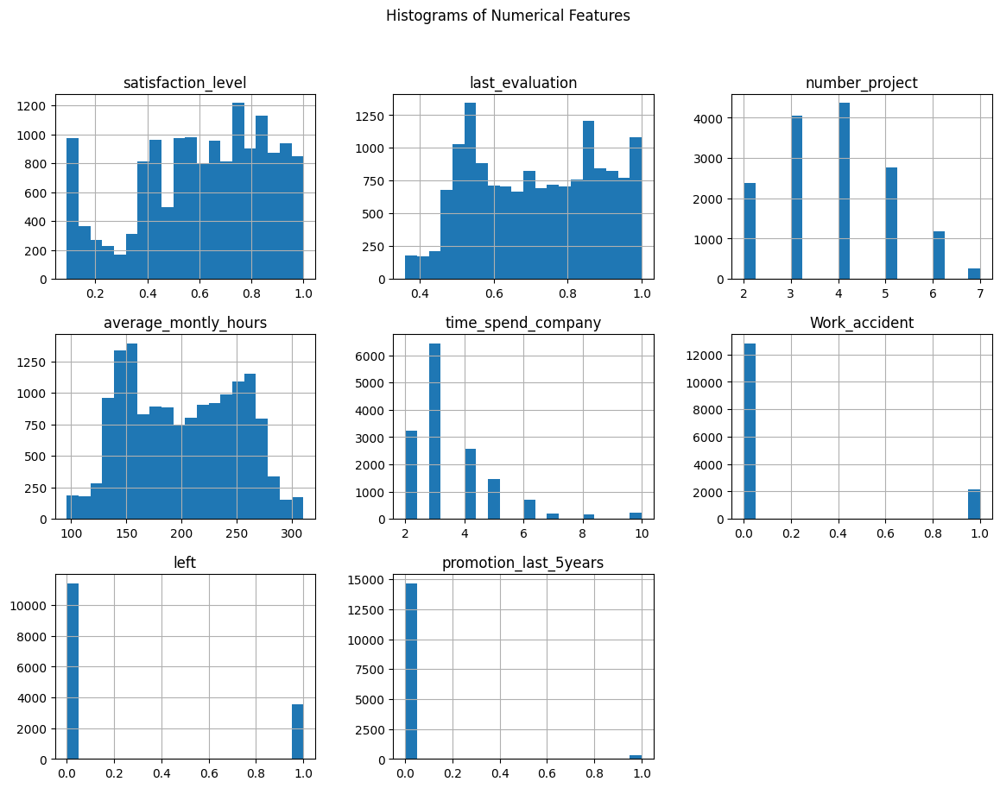

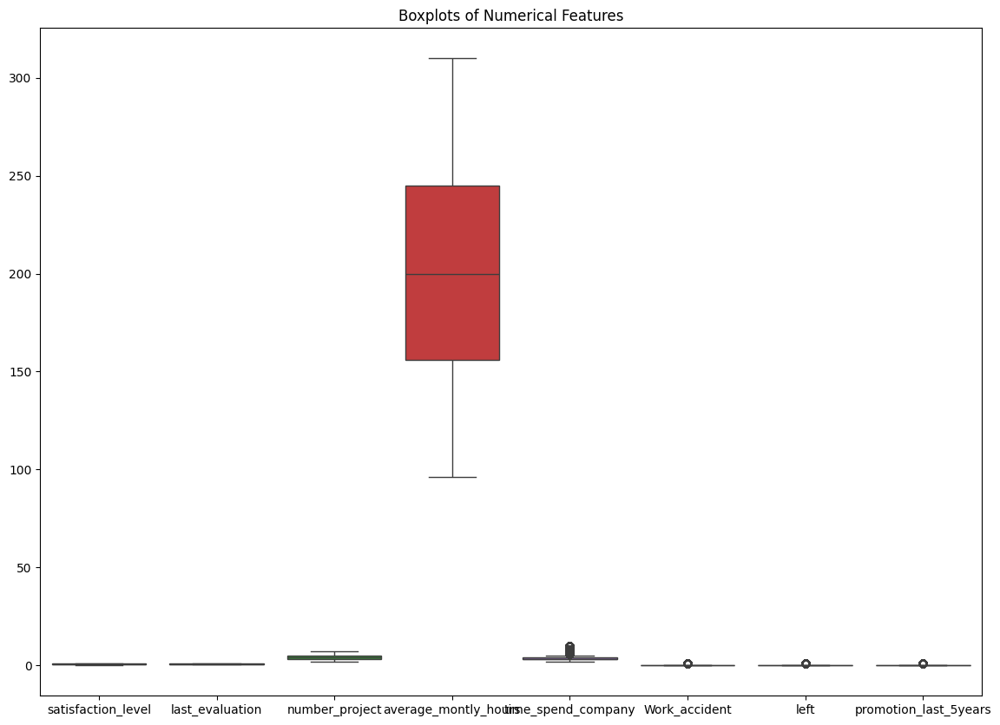

In [8]:
# Histograms for numerical columns
df.hist(bins=20, figsize=(14, 10))
plt.suptitle('Histograms of Numerical Features')
plt.show()

# Boxplots for numerical columns
plt.figure(figsize=(14, 10))
sns.boxplot(data=df.select_dtypes(include=[np.number]))
plt.title('Boxplots of Numerical Features')
plt.show()

***According to the basic examinations on the dataset;***

- We have a classification problem.
- We are going to make classification on the target variable "left".
- And we will build a model to get the best classification on the "left" column.
- Because of that we are going to look at the balance of "left" column.
- The dataset has 10 columns and 11991 observations after dropping of duplicated observations.
- 8 columns contain numerical values and 2 columns contain categorical values. 
- There seems to be no missing value. 

In [9]:
df.rename({'departments_': 'department'}, axis=1, inplace=True)
df.head(1)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low


In [10]:

columns_to_select = ['satisfaction_level', 'last_evaluation', 'number_project',
                     'average_montly_hours', 'time_spend_company', 'Work_accident',
                     'promotion_last_5years', 'Departments', 'salary', 'left']

# Check if all columns exist in the DataFrame
missing_columns = [col for col in columns_to_select if col not in df.columns]

if missing_columns:
    print(f"The following columns are missing from the DataFrame: {missing_columns}")
else:
    # Select columns if all are present
    df = df[columns_to_select]
    df.head(1)


The following columns are missing from the DataFrame: ['Departments']


### Data Insights

In the given dataset, we have two types of employee one who stayed and another who left the company. 
The following are the hypotheses to be tested through visualization and the ML model:

Hypothesis 1: The relationship between employee turnover and satisfaction level is negative.

Hypothesis 2: The relationship between employee turnover and last evaluation is negative.

Hypothesis 3: Employees with neutral satisfaction level and evaluation score have highest turnover rates due to low organisational and work commitment. 

Hypothesis 4: There is a negative relationship between time spent at company and turnover. 

Hypothesis 5: There is a positive relationship between 
work accidents and turnover. 

Hypothesis 6: There is a negative relationship between number of promotions and turnover.

Hypothesis 7: There is a negative relationship between  level of salary and turnover.


**'left' Column-Target Column**

In [11]:
cprint("Have a First Look to 'left' Column",'green')
first_look('left')


Have a First Look to 'left' Column
column name    :  left
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  3008
left
0    11428
1     3571
Name: count, dtype: int64


In [12]:
import plotly.express as px

# Calculate value counts for the 'left' column
left_counts = df['left'].value_counts()

# Create pie chart using Plotly Express
fig = px.pie(names=left_counts.index, values=left_counts.values, title='"left" Column Distribution')
fig.show()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

In [ ]:
y = df['left']
print(f'Percentage of left-1: % {round(y.value_counts(normalize=True)[1]*100,2)} --> \
({y.value_counts()[1]} observations for left-1)\nPercentage of left-0: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} observations for left-0)')

Percentage of left-1: % 23.81 --> (3571 observations for left-1)
Percentage of left-0: % 76.19 --> (11428 observations for left-0)


- 'left' column has binary type values.
- We have an imbalanced data.
- Almost 24% of the employees didn't continue with the company and left.
- 3571 employees left.
- Almost 76% of the employees continue with the company and didn't leave.
- 11428 employees didn't leave.

In [ ]:
# Select only numeric columns
numeric_columns = df.select_dtypes(include='number')

# Calculate mean for each group separately
left_mean = numeric_columns.groupby('left').mean()

# Display the result
left_mean


,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,promotion_last_5years
left,,,,,,,
0,0.666810,0.715473,3.786664,199.060203,3.380032,0.175009,0.026251
1,0.440098,0.718113,3.855503,207.419210,3.876505,0.047326,0.005321


- last_evaluation, number_project seem to have least influence on 'left'
- average_monthly_hours, promotion_last_5years seem to have most influence on 'left'

In [ ]:
cprint('Dataset describe results according to the "left==1" condition','black', 'on_blue')
df[df['left'] == 1].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'RdPu')

Dataset describe results according to the "left==1" condition


,count,mean,std,min,25%,50%,75%,max
satisfaction_level,3571.000000,0.440098,0.263933,0.090000,0.130000,0.410000,0.730000,0.920000
last_evaluation,3571.000000,0.718113,0.197673,0.450000,0.520000,0.790000,0.900000,1.000000
number_project,3571.000000,3.855503,1.818165,2.000000,2.000000,4.000000,6.000000,7.000000
average_montly_hours,3571.000000,207.419210,61.202825,126.000000,146.000000,224.000000,262.000000,310.000000
time_spend_company,3571.000000,3.876505,0.977698,2.000000,3.000000,4.000000,5.000000,6.000000
Work_accident,3571.000000,0.047326,0.212364,0.000000,0.000000,0.000000,0.000000,1.000000
left,3571.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
promotion_last_5years,3571.000000,0.005321,0.072759,0.000000,0.000000,0.000000,0.000000,1.000000


In [ ]:
cprint('Dataset describe results according to the "left==0" condition','black', 'on_blue')
df[df['left'] == 0].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'RdPu')

Dataset describe results according to the "left==0" condition


,count,mean,std,min,25%,50%,75%,max
satisfaction_level,11428.000000,0.666810,0.217104,0.120000,0.540000,0.690000,0.840000,1.000000
last_evaluation,11428.000000,0.715473,0.162005,0.360000,0.580000,0.710000,0.850000,1.000000
number_project,11428.000000,3.786664,0.979884,2.000000,3.000000,4.000000,4.000000,6.000000
average_montly_hours,11428.000000,199.060203,45.682731,96.000000,162.000000,198.000000,238.000000,287.000000
time_spend_company,11428.000000,3.380032,1.562348,2.000000,2.000000,3.000000,4.000000,10.000000
Work_accident,11428.000000,0.175009,0.379991,0.000000,0.000000,0.000000,0.000000,1.000000
left,11428.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
promotion_last_5years,11428.000000,0.026251,0.159889,0.000000,0.000000,0.000000,0.000000,1.000000


**'satisfaction_level' Column**

In [ ]:
cprint("Have a First Look to 'left' Column",'black', 'on_blue')
first_look('satisfaction_level')

Have a First Look to 'left' Column


NameError: name 'first_look' is not defined

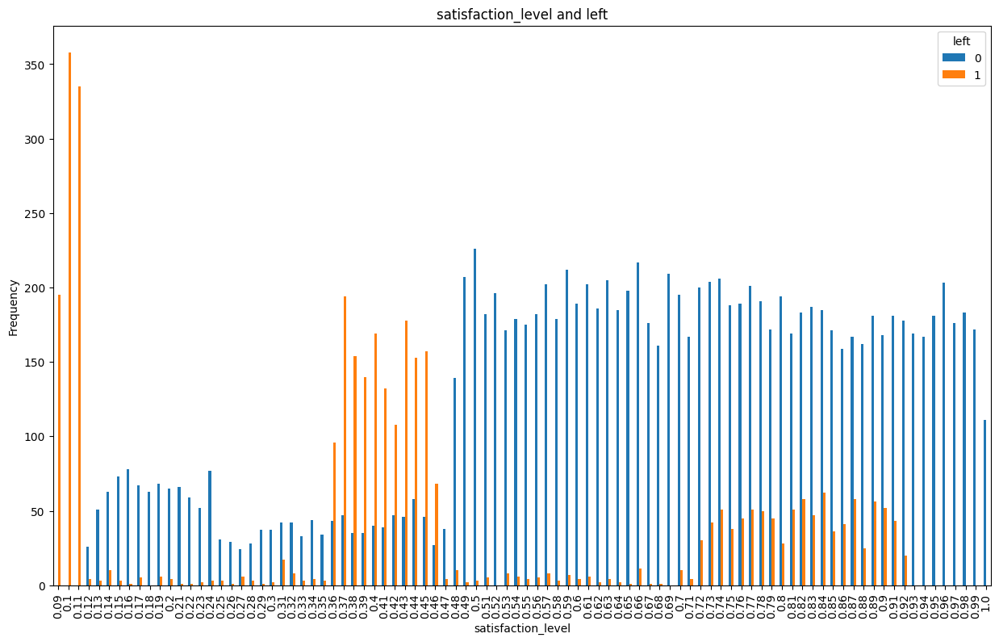

In [ ]:
import matplotlib.pyplot as plt

# Create a crosstab
crosstab = pd.crosstab(df['satisfaction_level'], df['left'])

# Plot the crosstab as a bar plot
crosstab.plot(kind='bar', title='satisfaction_level and left', figsize=(15, 9))
plt.xlabel('satisfaction_level')
plt.ylabel('Frequency')
plt.show()


- Although it comes to mind that there should be a linear relationship between 'satisfaction_level' and 'left', it does not look like this on the graph. 
- Those with a 'satisfaction_level' value of around 0.1 are very likely to 'left'. 
- There is a significant increase in the number of those whose 'satisfaction_level' value is between 3.5 and 4.5 and 'left'. In fact, the number of left ones exceeds the notleft ones. 
- When the 'satisfaction_level' value is between 7 and 9, there is an increase in the number of those left. 

- Normally we expect low satisfaction level for the employees who has left, so the part near to 0 on the x-axis is make sense.
- Besides a group of employee who are not very decisive about their satisfaction level have also been left the company. This group may need extra motivation for employee loyalty. Because they are not so clear in their assesments about their future in the company.
- Also a group of employee whose satisfaction level is above the avarage have been left the company. This does not make sense so this must be investigate deeply.

There may be some other issues:

a. The method of gathering this information may be wrong. So the assessment of satisfaction level and the resignings may not be directly proportional.

b. The assessment may not be up to date. By the time the satisfaction level may be decreased so at the real time the satisfaction level of all resigning employees may be close to 0.

c. Some of the employees may have hidden their true feelings.

**'last_evaluation' Column**

In [ ]:
cprint("Have a First Look to 'last_evaluation' Column",'green')
first_look('last_evaluation')

Have a First Look to 'last_evaluation' Column
column name    :  last_evaluation
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  65
Duplicates     :  3008
last_evaluation
0.55    358
0.50    353
0.54    350
0.51    345
0.57    333
       ... 
0.39     52
0.43     50
0.38     50
0.44     44
0.36     22
Name: count, Length: 65, dtype: int64


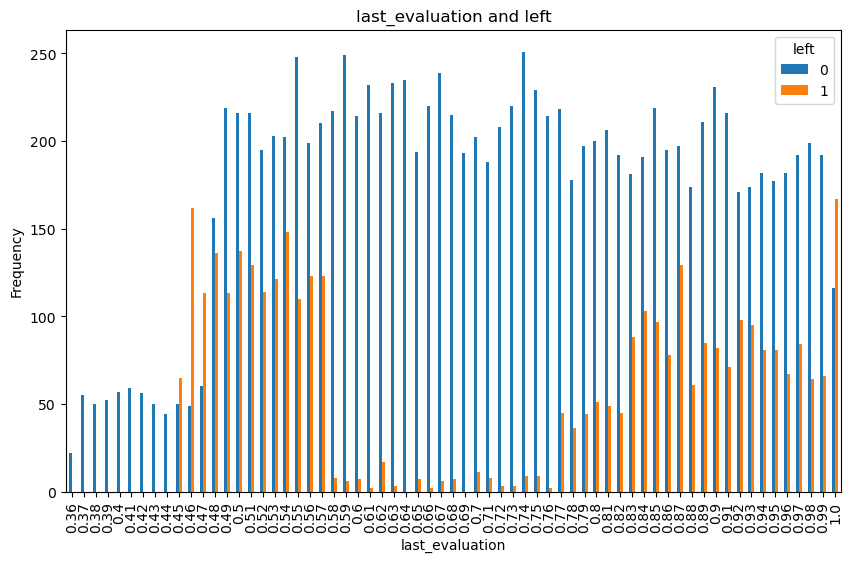

In [ ]:
# Create a crosstab
crosstab = pd.crosstab(df['last_evaluation'], df['left'])

# Plot the crosstab as a bar plot
crosstab.plot(kind='bar', title='last_evaluation and left', figsize=(10, 6))
plt.xlabel('last_evaluation')
plt.ylabel('Frequency')
plt.show()


- Most of the employees have been assessed above 0.4.
- There is a local increase between 0.45-0.6 and 0.8-1 in 'last_evaluation' values, as in 'satisfaction_level' values. There is an increase in the number of people who quit their jobs in these intervals
- The evaluation of the resigning employees are gather in two groups. First is around the 0.5 and the second is between 0.8 and 1.0.
- Intensive work may cause the resign of high evaluated employees (second group). Because employer will be happy with performance of these staff, however it will be a burden for employee.

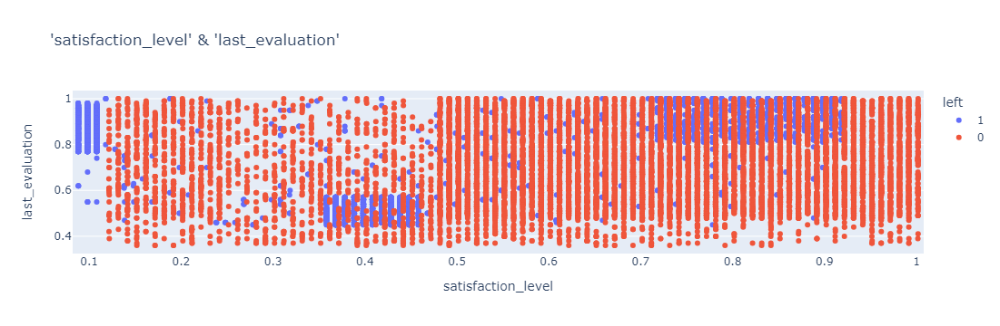

In [ ]:
fig = px.strip(df, x = 'satisfaction_level', y = 'last_evaluation', color = 'left',
               title = "'satisfaction_level' & 'last_evaluation'")
fig.show()

It becomes meaningful when the satisfaction level of employees and the evaluation of the employer brings together.

As seen in the graph; the resigning employees are grouping in three diferent clusters.

1. First group has a satisfaction level of 0.4 and last evaluation of 0.5.  This group as not a clear idea about the company and the employer does not have a clear assessment about them. Other features affecting this group have to be investigated. 
2. The second group has a low satisfaction even if the employer evaluated them with high degrees. 
Intensive work with a low salary may affect this group.
Or intensive work without promotion may cause.
On the next steps workload and motivation factors of this group have to be investigated.
3. The third group has a high satisfaction level and evaluation point as well. The density of this group is fewer than the others. The issues that triger the leave of this group need to be investigated.

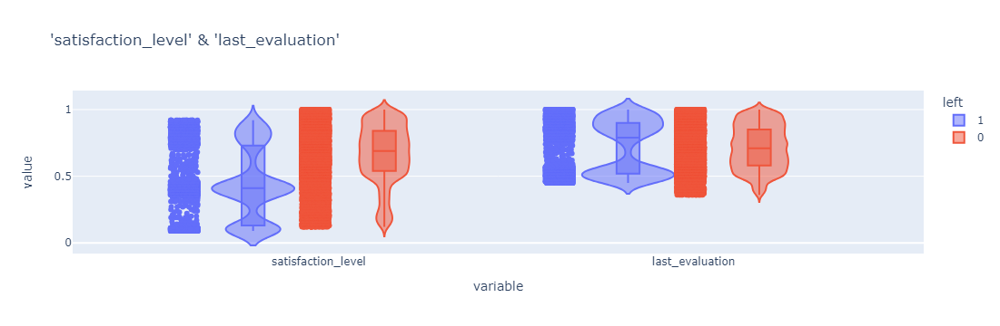

In [ ]:
fig = px.violin(df[['satisfaction_level', 'last_evaluation', 'left']], color = 'left', box = True, points='all',
                title = "'satisfaction_level' & 'last_evaluation'")
fig.show()

**'number_project' Column**

In [ ]:
cprint("Have a First Look to 'number_project' Column",'green')
first_look('number_project')

Have a First Look to 'number_project' Column
column name    :  number_project
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  6
Duplicates     :  3008
number_project
4    4365
3    4055
5    2761
2    2388
6    1174
7     256
Name: count, dtype: int64


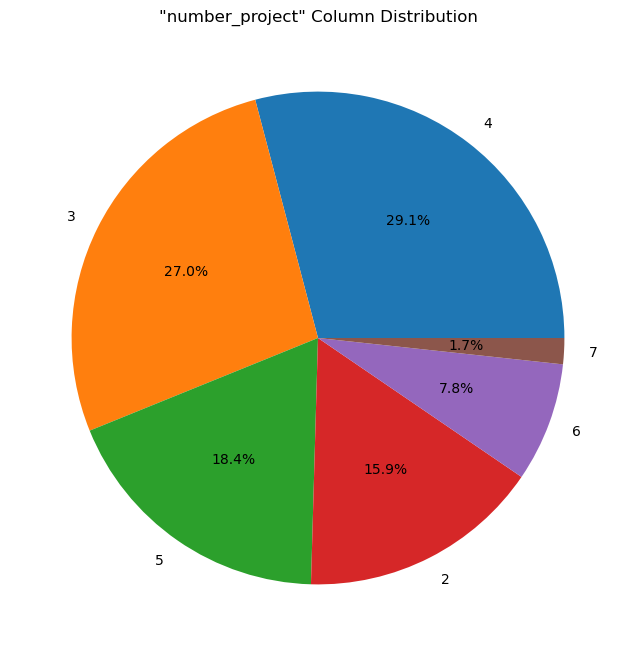

In [ ]:
# Get the value counts of 'number_project' column
value_counts = df['number_project'].value_counts()

# Plot a pie chart
plt.figure(figsize=(8, 8))
plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%')
plt.title('"number_project" Column Distribution')
plt.show()


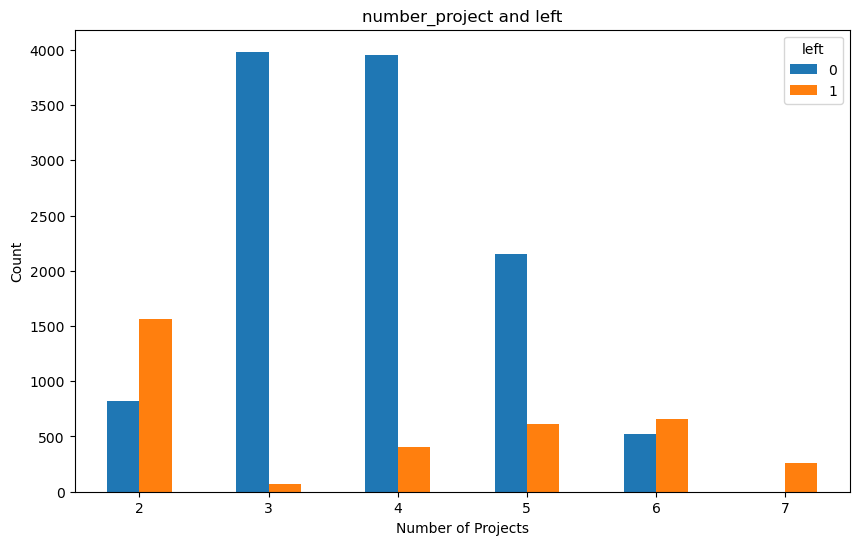

In [ ]:
# Create a crosstab of 'number_project' and 'left' columns
crosstab = pd.crosstab(df['number_project'], df['left'])

# Plot a bar plot
crosstab.plot(kind='bar', figsize=(10, 6))
plt.title('number_project and left')
plt.xlabel('Number of Projects')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()


The number of leaving employees is higher among those who have only two projects during the period. This can be summed up as: "the employees with only two projects feel worthless or emptied". Because most of the employees work on three or four projects.

With the 6th project, the number of resignings is getting over the number of ongoings. There are no ongoing staff members who were assigned to 7 projects.

Working on more projects may cause intensive workload,  regarding to this the satisfaction level may decrease with the insufficient motivators.

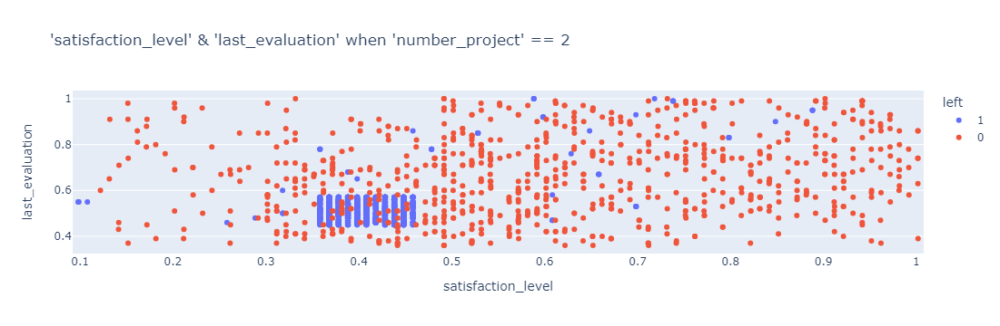

In [ ]:
fig = px.strip(df[df['number_project'] == 2], x = 'satisfaction_level', y = 'last_evaluation', color = 'left',
               title = "'satisfaction_level' & 'last_evaluation' when 'number_project' == 2")
fig.show()

If we look at the satisfaction level, evaluation score and the number of projects together;

The group of undecideds who were evaluated as 0.5 are the group who worked on the only two projects. As aresult our hypothesis about this group is becoming more clear. As the employer does not assign enough projects to this group, he/she cannot evaluate their performance and they feel worthless. Therefore, they are unsure about their future in the company. This may lead them to leave.

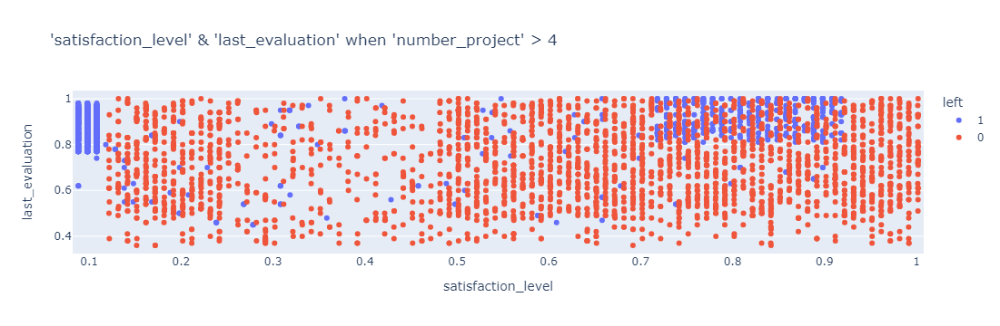

In [ ]:
fig = px.strip(df[df['number_project'] > 4], x = 'satisfaction_level', y = 'last_evaluation', color = 'left',
               title = "'satisfaction_level' & 'last_evaluation' when 'number_project' > 4")
fig.show()

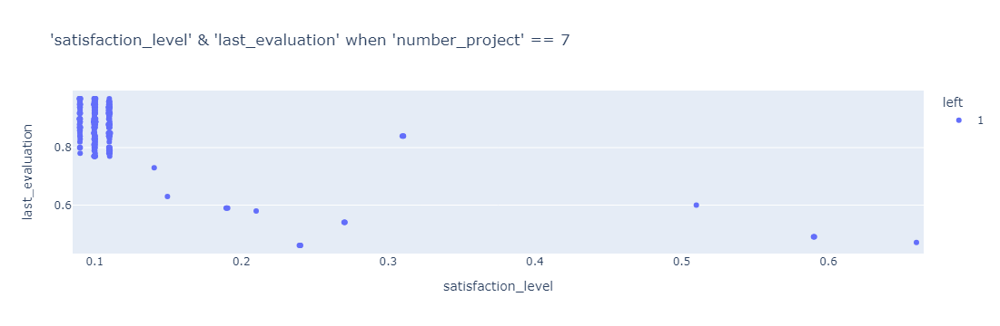

In [ ]:
fig = px.strip(df[df['number_project'] == 7], x = 'satisfaction_level', y = 'last_evaluation', color = 'left',
               title = "'satisfaction_level' & 'last_evaluation' when 'number_project' == 7")
fig.show()

The leaving employees who worked on more than four projects are the group two and three of the last_evaluation section.

Especially most of the second group of last_evaluation section are worked on seven projects and left the company. So again our hypothesis about this group is now more definite.

**'average_montly_hours' Column**

In [ ]:
cprint("Have a First Look to 'average_montly_hours' Column",'green')
first_look('average_montly_hours')

Have a First Look to 'average_montly_hours' Column
column name    :  average_montly_hours
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  215
Duplicates     :  3008
average_montly_hours
135    153
156    153
149    148
151    147
160    136
      ... 
297      7
288      6
299      6
96       6
303      6
Name: count, Length: 215, dtype: int64


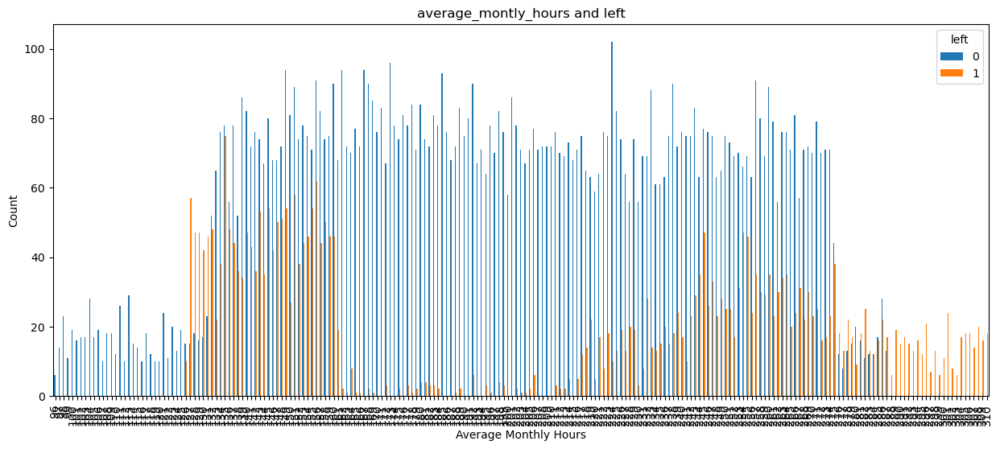

In [ ]:
# Create a crosstab of 'average_montly_hours' and 'left' columns
crosstab = pd.crosstab(df['average_montly_hours'], df['left'])

# Plot a bar plot
crosstab.plot(kind='bar', figsize=(15, 6))
plt.title('average_montly_hours and left')
plt.xlabel('Average Monthly Hours')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()


- Looking at the 'average_montly_hours' values, there is a local increase in turnover in the 125-160 monthly working hours range and 210-290 monthly working hours. 
- Those who work more than 290 hours per month are more likely to quit their jobs than those who do not. 
- So the next question is "The average monthly working hours are related to projects number or not?"

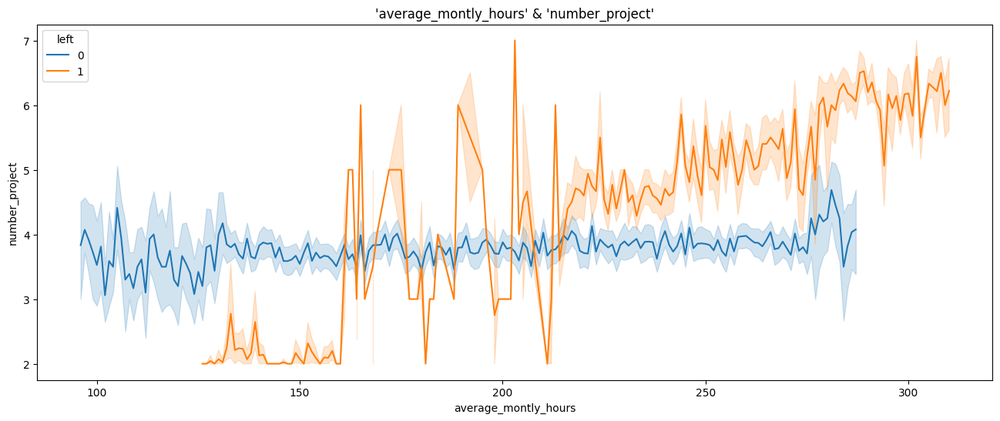

In [ ]:
plt.figure(figsize = (16,6))
sns.lineplot(data = df, x = 'average_montly_hours', y = 'number_project', hue = 'left')
plt.title("'average_montly_hours' & 'number_project'")
plt.show()

At the graph above it is seen that the group working on two projects is working nearly 130-160 hours monthly. It can be assessed that they have only two simple projects that they don't need to work hard, so their loyalty is weak.

Most of the employees are working 135-275 hours monthly. In this group usually the employees who get two or more than five projects leaving the company.
By the increasing number of projects the avarage monhtly working hours and the number of resignings are increasing.

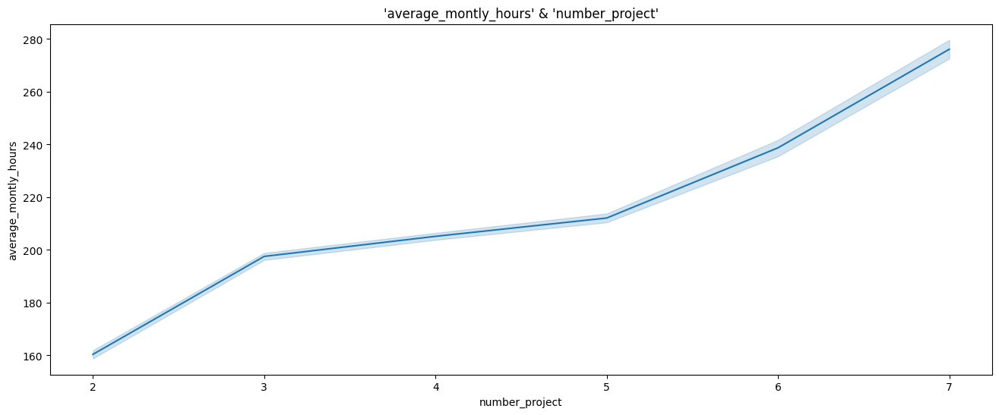

In [ ]:
plt.figure(figsize = (16,6))
sns.lineplot(data = df, y = 'average_montly_hours', x = 'number_project')
plt.title("'average_montly_hours' & 'number_project'")
plt.show()

The increasing of the avarage monthly hours according to number of projects is seen on the graph.

The rate of increase is higher between two and three projects, and after five projects. So it is clearly define the number of resignings due to the working hours.

**There need to be an adjustment about the project numbers, working hours and workload. The projects must be assigned to more employees. Also, better incentives must be offered to staff who are working hard.**

**'time_spend_company' Column**

In [ ]:
cprint("Have a First Look to 'time_spend_company' Column",'green')
first_look('number_project')

Have a First Look to 'time_spend_company' Column
column name    :  number_project
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  6
Duplicates     :  3008
number_project
4    4365
3    4055
5    2761
2    2388
6    1174
7     256
Name: count, dtype: int64


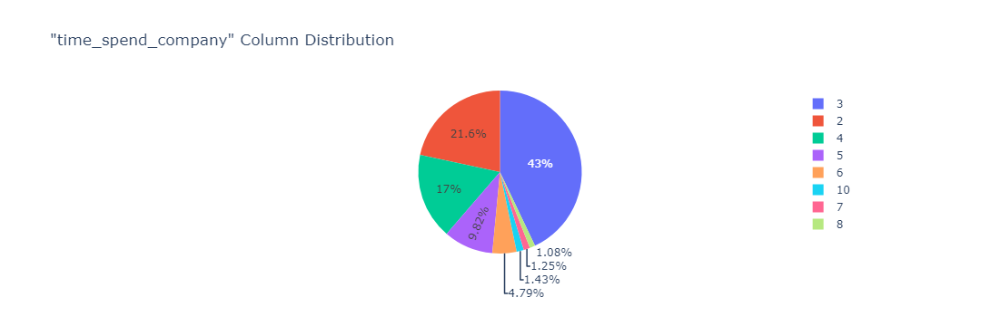

In [ ]:
import plotly.express as px

# Count the occurrences of each value in the 'time_spend_company' column
time_spend_company_counts = df['time_spend_company'].value_counts()

# Create a pie chart using Plotly Express
fig = px.pie(values=time_spend_company_counts.values,
             names=time_spend_company_counts.index,
             title='"time_spend_company" Column Distribution')
fig.show()


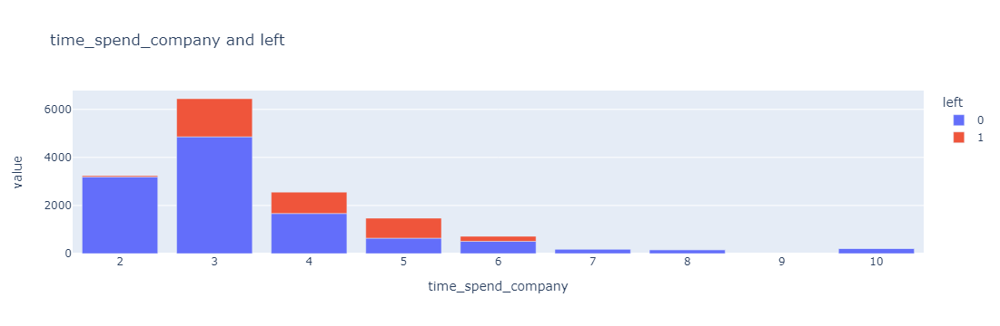

In [ ]:

# Create a cross-tabulation of 'time_spend_company' and 'left' columns
time_left_cross = pd.crosstab(df['time_spend_company'], df['left'])

# Plot the cross-tabulation as a bar chart using Plotly Express
fig = px.bar(time_left_cross, x=time_left_cross.index, y=time_left_cross.columns, 
             title='time_spend_company and left')
fig.show()


- Looking at the 'time_spent_company' values, there is an increase in turnover in the 3rd working year, but this increase gradually decreases until the 6th working year. 

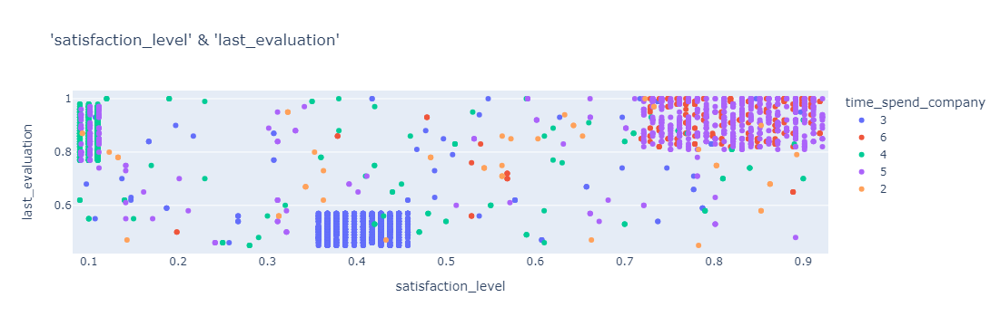

In [ ]:
fig = px.strip(df[df['left'] == 1], x = 'satisfaction_level', y = 'last_evaluation', color = 'time_spend_company',
               title ="'satisfaction_level' & 'last_evaluation'")
fig.show()

As can be seen on the graph, the employees are not able to make a clear assessment of the company during the first three years of their employment. This, coupled with the other factors, tends to lead to leaving the company after three years.

By the fourth year, their workload increases and their satisfaction decreases.

After the fifth year, they make an assessment, "they will leave or not".

If they decide to continue in the company, they never consider leaving after the sixth year.

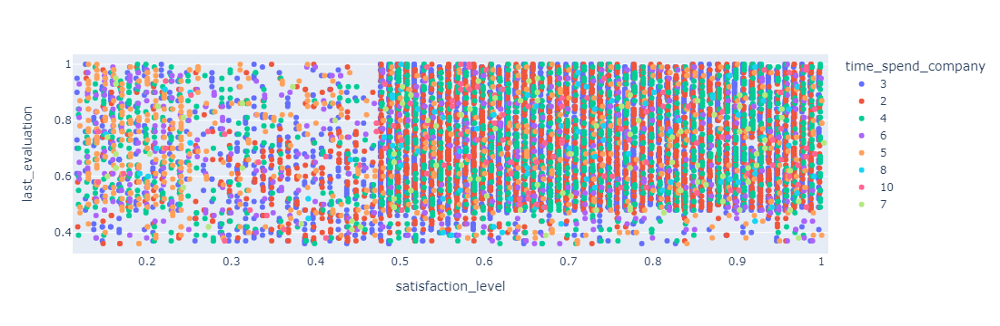

In [ ]:
fig = px.strip(df[df['left'] == 0], x = 'satisfaction_level', y = 'last_evaluation', color = 'time_spend_company')
fig.show()

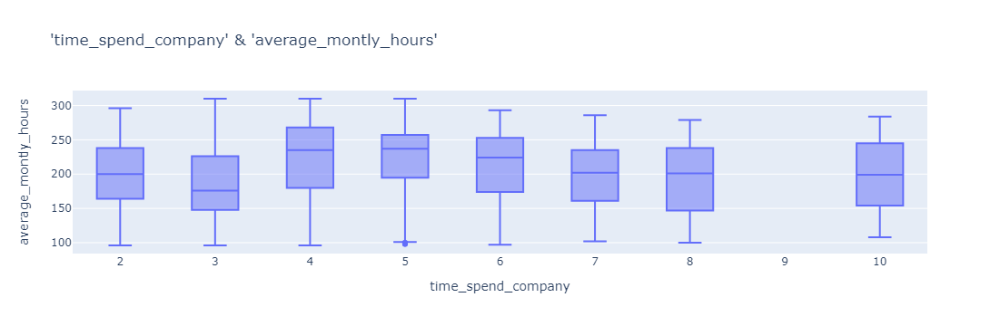

In [ ]:
fig = px.box(df, x = 'time_spend_company', y = 'average_montly_hours', title = "'time_spend_company' & 'average_montly_hours'")
fig.show()

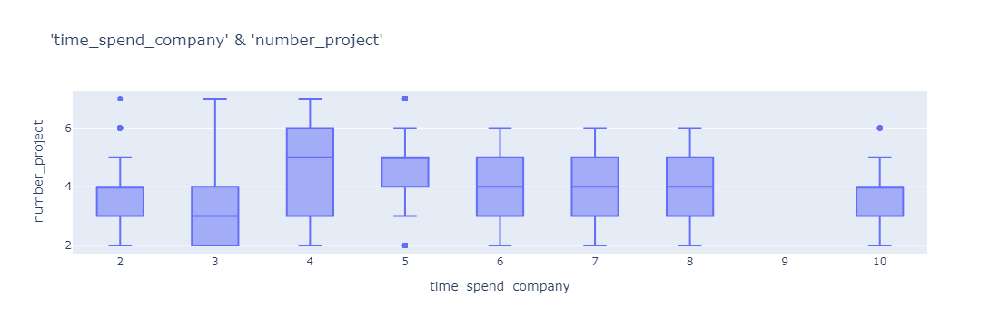

In [ ]:
fig = px.box(df, x = 'time_spend_company', y = 'number_project', title = "'time_spend_company' & 'number_project'")
fig.show()

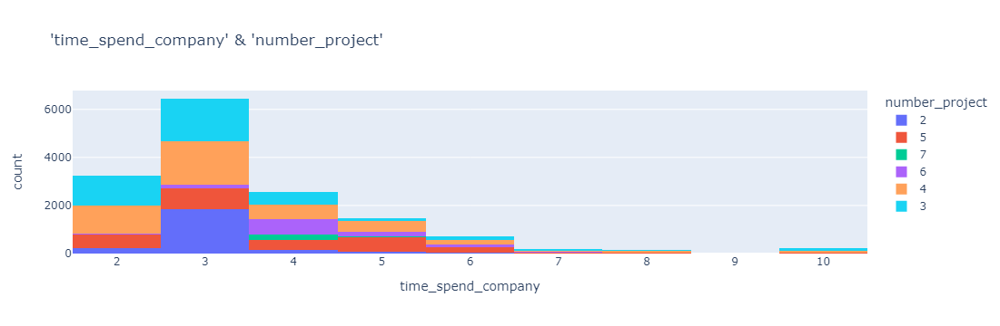

In [ ]:
px.histogram(df, x = 'time_spend_company', color = 'number_project', title = "'time_spend_company' & 'number_project'")

***Then how is the relation between workload and time spend in the company?***

Third year staff has the most workload. After that year number of participated project is decreasing stepped. It is make sense. The experienced staff becoming team leader or manager position. That's why less of them can be assigned to projects.

**'work_accident' Column**

In [ ]:
column_name = 'Work_accident'

if column_name in df.columns:
    print("Have a First Look to '{}' Column".format(column_name))
    first_look(column_name)
else:
    print("'{}' column does not exist in the DataFrame.".format(column_name))


Have a First Look to 'Work_accident' Column
column name    :  Work_accident
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  3008
Work_accident
0    12830
1     2169
Name: count, dtype: int64


In [ ]:
column_name = 'Work_accident'.strip()
value_counts = df[column_name].value_counts()

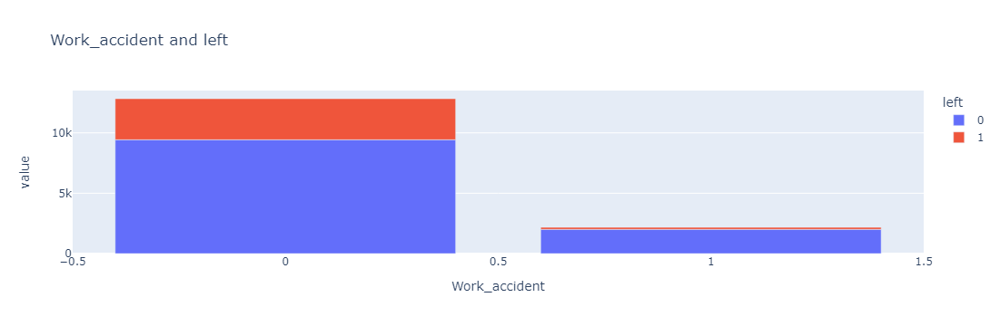

In [ ]:
# Calculate the cross-tabulation
cross_tab = pd.crosstab(df['Work_accident'], df['left'])

# Plot the bar chart using Plotly
fig = px.bar(cross_tab, title='Work_accident and left')
fig.show()


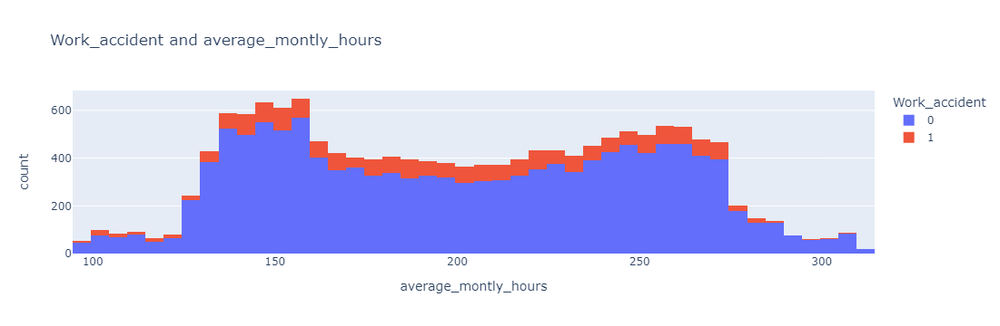

In [ ]:
# Plot the histogram using Plotly
fig = px.histogram(df, x='average_montly_hours', color='Work_accident', title='Work_accident and average_montly_hours')
fig.show()


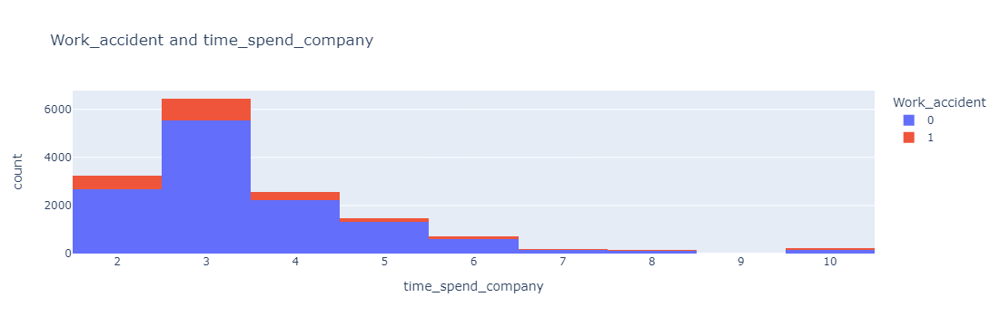

In [ ]:
# Plot the histogram using Plotly
fig = px.histogram(df, x='time_spend_company', color='Work_accident', title='Work_accident and time_spend_company')
fig.show()


- 'work_accident' column has binary type values.
- Left ratios are similar between those who have had a work accident and those who have not. 
- It does not appear to be a determining factor. In fact, it can be said that the left rate of those who have had a work accident is proportionally lower. 

**'promotion_last_5years' Column**

In [ ]:
cprint("Have a First Look to 'promotion_last_5years' Column",'green')
first_look('promotion_last_5years')

Have a First Look to 'promotion_last_5years' Column
column name    :  promotion_last_5years
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  3008
promotion_last_5years
0    14680
1      319
Name: count, dtype: int64


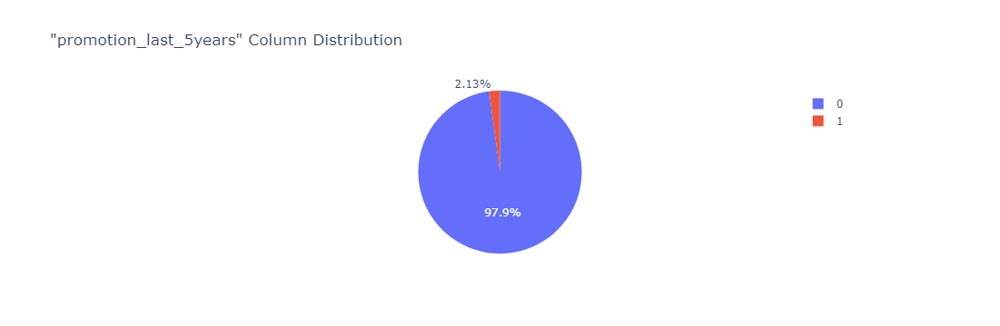

In [ ]:
# Calculate value counts for 'promotion_last_5years' column
value_counts = df['promotion_last_5years'].value_counts()

# Plot the pie chart using Plotly
fig = px.pie(names=value_counts.index, values=value_counts.values, title='"promotion_last_5years" Column Distribution')
fig.show()


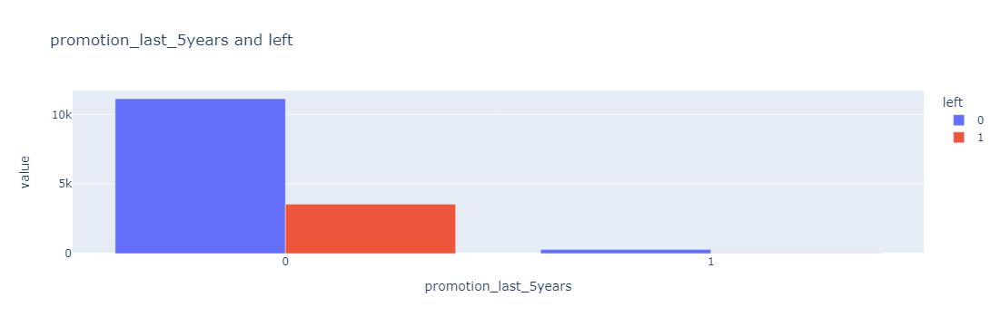

In [ ]:
# Create a DataFrame with crosstab results
crosstab_df = pd.crosstab(df['promotion_last_5years'], df['left'])

# Plot the bar chart using Plotly
fig = px.bar(crosstab_df, barmode='group', title='promotion_last_5years and left')
fig.show()



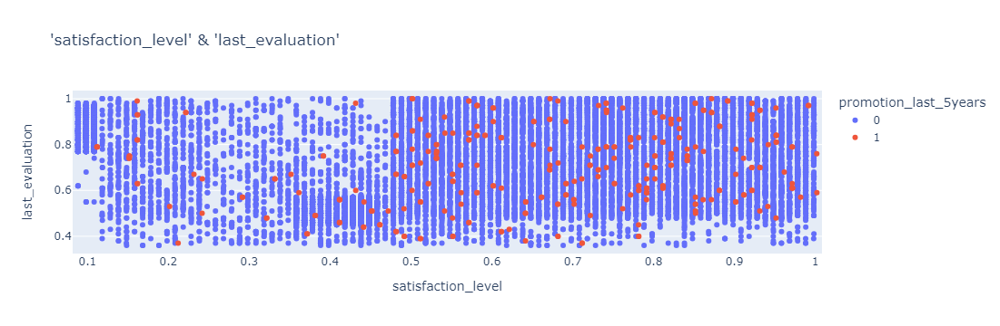

In [ ]:
fig = px.strip(df, x = 'satisfaction_level', y = 'last_evaluation', color = 'promotion_last_5years',
               title = "'satisfaction_level' & 'last_evaluation'")
fig.show()

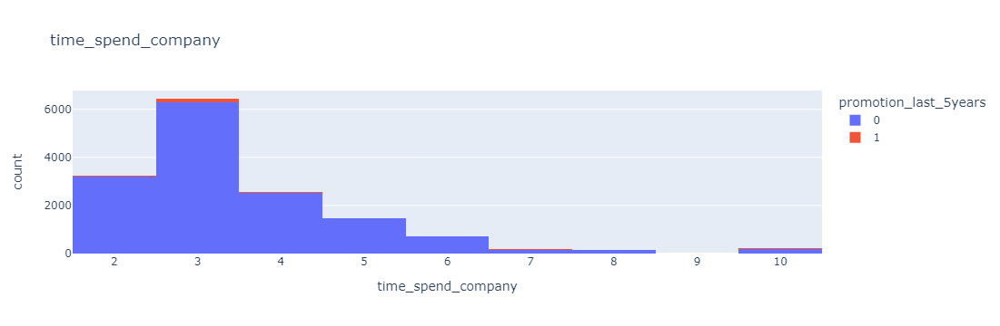

In [ ]:
px.histogram(df, x = df['time_spend_company'], color='promotion_last_5years', title = 'time_spend_company')

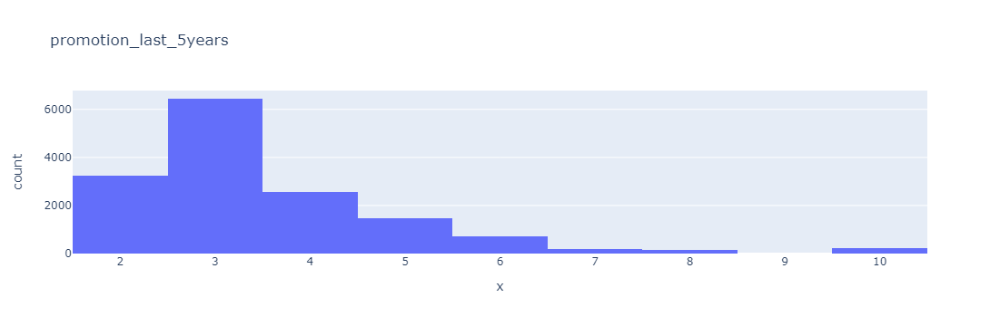

In [ ]:
px.histogram(df[df['promotion_last_5years'] == 1], x = df['time_spend_company'], title = 'promotion_last_5years')

- 'promotion_last_5years' column has binary type values.
- Receiving a promotion in the last 5 working years is not determinative in terms of leaving or continuing to work. 

**'department' Column**

In [ ]:
cprint("Have a First Look to 'Departments' Column", 'green')
first_look('Departments ')

Have a First Look to 'Departments' Column
column name    :  Departments 
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  10
Duplicates     :  3008
Departments 
sales          4140
technical      2720
support        2229
IT             1227
product_mng     902
marketing       858
RandD           787
accounting      767
hr              739
management      630
Name: count, dtype: int64


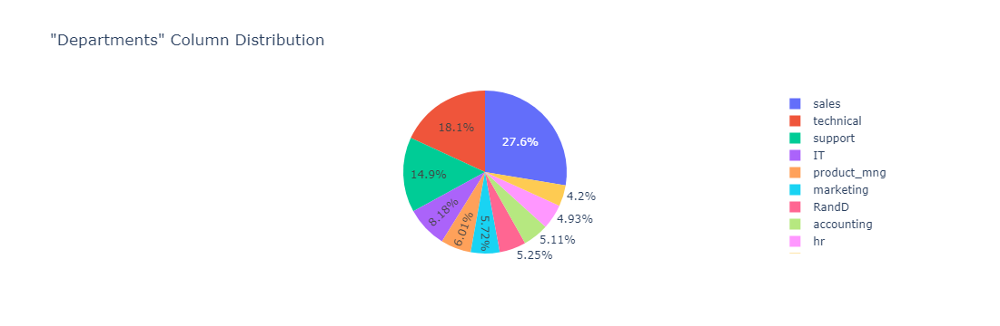

In [ ]:

fig = px.pie(df, names='Departments ', title='"Departments" Column Distribution')
fig.show()


In [ ]:
df_dep = (
    pd.crosstab(df['Departments '], df['left'])
    .rename(columns={0: 'not_left', 1: 'left'})
    .assign(total=lambda x: x['not_left'] + x['left'])
    .assign(left_percentage=lambda x: (x['left'] / x['total'] * 100))
)


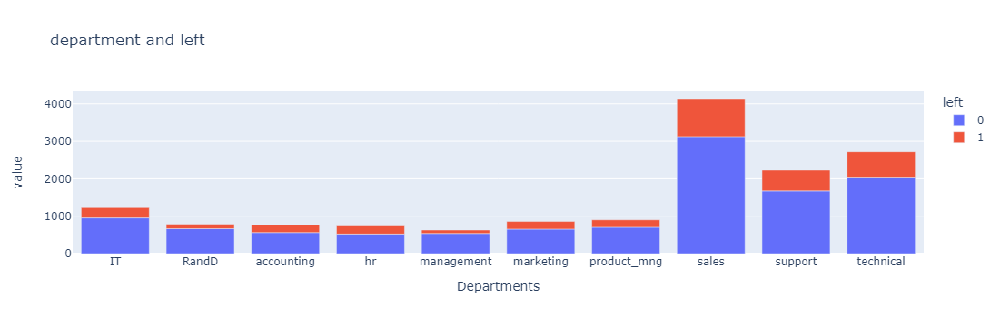

In [ ]:
crosstab_df = pd.crosstab(df['Departments '], df['left'])

fig = px.bar(crosstab_df, x=crosstab_df.index, y=crosstab_df.columns, title='department and left')
fig.show()


- It is not observed that the departments worked alone have an effect on the left decision. 
- It is seen that the left percentages of the departments are similar. 

**'salary' Column**

In [ ]:
cprint("Have a First Look to 'salary' Column",'green')
first_look('salary')

Have a First Look to 'salary' Column
column name    :  salary
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  3
Duplicates     :  3008
salary
low       7316
medium    6446
high      1237
Name: count, dtype: int64


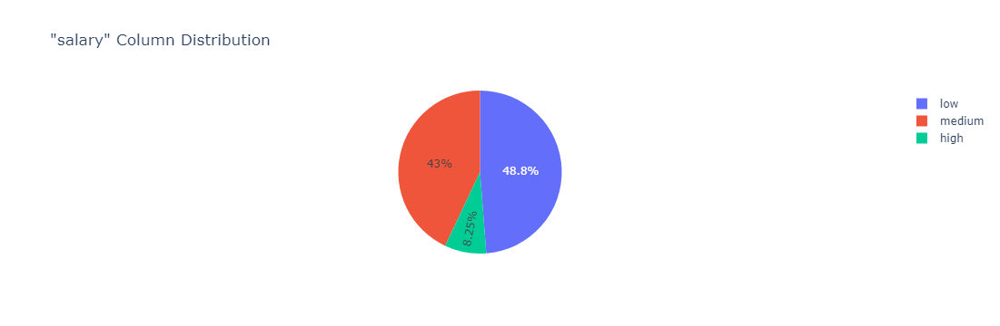

In [ ]:
# Check if 'salary' column exists in the DataFrame
if 'salary' in df.columns:
    # Generate a pie chart for the 'salary' column distribution
    salary_counts = df['salary'].value_counts()
    fig = px.pie(values=salary_counts, names=salary_counts.index, title='"salary" Column Distribution')
    fig.show()
else:
    print("The 'salary' column does not exist in the DataFrame.")


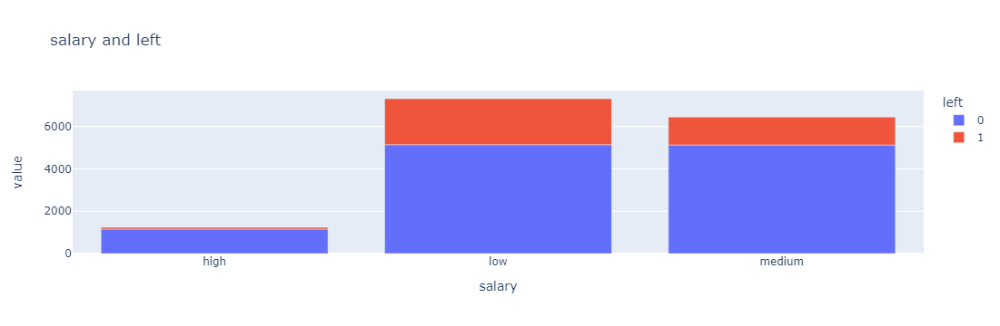

In [ ]:
# Create a cross-tabulation of 'salary' and 'left' columns
crosstab_df = pd.crosstab(df['salary'], df['left'])

# Plot the bar chart using Plotly Express
fig = px.bar(crosstab_df, x=crosstab_df.index, y=crosstab_df.columns, title='salary and left')
fig.show()


- It is seen that the left percentages of the salary are similar. 
- Even if it is small, there is an increase in the form of high-medium-low according to the salary status. 

***Let's go on with the examination of numerical and categorical columns.***

In [ ]:
numerical= df.drop(['left'], axis = 1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print('---------------------')
print(f'Numerical Columns:  {df[numerical].columns}')
print(f'Categorical Columns: {df[categorical].columns}')
print('---------------------')

---------------------
Numerical Columns:  Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident',
       'promotion_last_5years'],
      dtype='object')
Categorical Columns: Index(['Departments ', 'salary'], dtype='object')
---------------------


In [ ]:
df[numerical].describe().T.style.background_gradient(subset = ['mean','std','50%','count'], cmap = 'RdPu')

,count,mean,std,min,25%,50%,75%,max
satisfaction_level,14999.000000,0.612834,0.248631,0.090000,0.440000,0.640000,0.820000,1.000000
last_evaluation,14999.000000,0.716102,0.171169,0.360000,0.560000,0.720000,0.870000,1.000000
number_project,14999.000000,3.803054,1.232592,2.000000,3.000000,4.000000,5.000000,7.000000
average_montly_hours,14999.000000,201.050337,49.943099,96.000000,156.000000,200.000000,245.000000,310.000000
time_spend_company,14999.000000,3.498233,1.460136,2.000000,3.000000,3.000000,4.000000,10.000000
Work_accident,14999.000000,0.144610,0.351719,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,14999.000000,0.021268,0.144281,0.000000,0.000000,0.000000,0.000000,1.000000


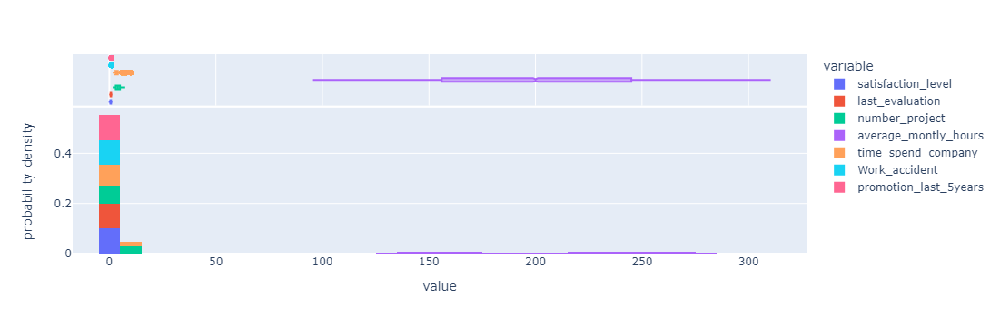

In [ ]:
# Plot histograms for numerical columns using Plotly Express
fig = px.histogram(df[numerical], nbins=50, marginal="box", histnorm='probability density')
fig.show()


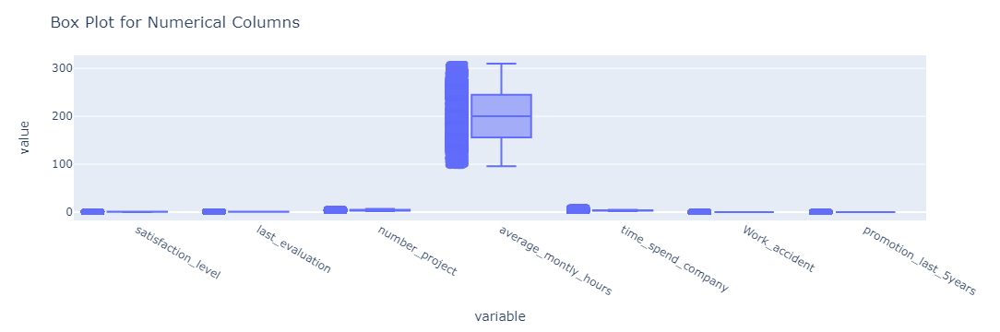

In [ ]:
# Create box plots for each numerical column using Plotly Express
fig = px.box(df[numerical], points="all")
fig.update_layout(title="Box Plot for Numerical Columns")
fig.show()


C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version

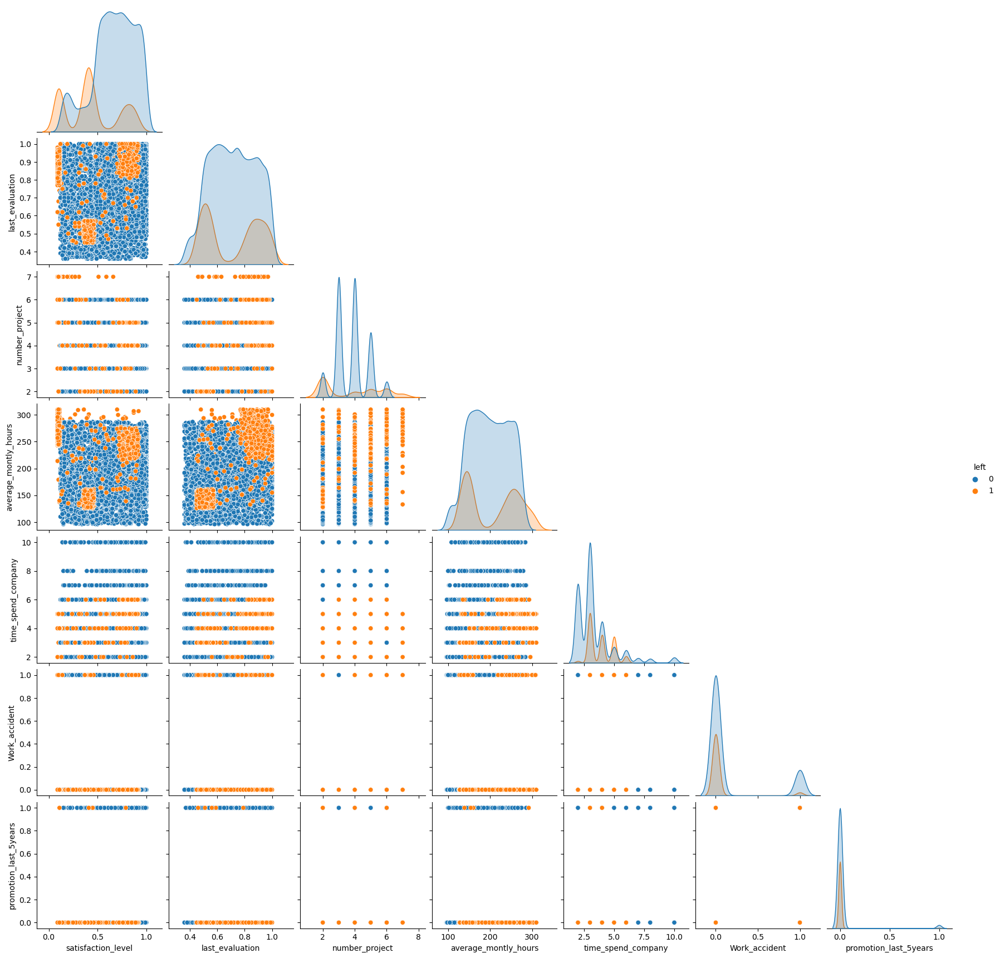

In [ ]:
sns.pairplot(df, hue = "left", corner = True);

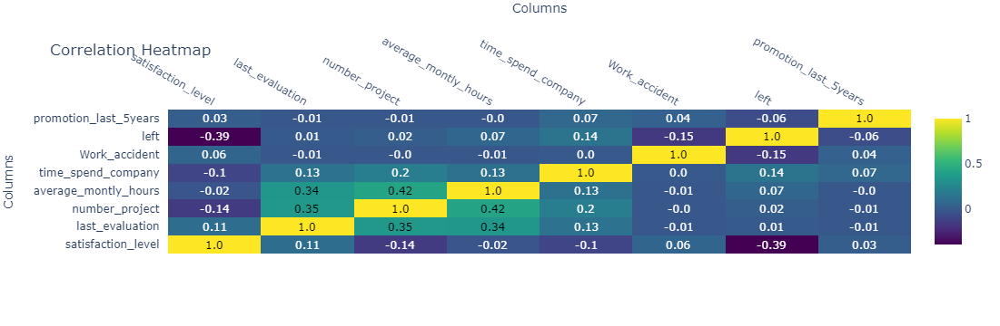

In [ ]:
import plotly.figure_factory as ff

# Filter only numeric columns
numeric_df = df.select_dtypes(include=['number'])

# Create a heatmap of the correlation matrix using Plotly
fig = ff.create_annotated_heatmap(z=numeric_df.corr().values,
                                  x=list(numeric_df.corr().columns),
                                  y=list(numeric_df.corr().index),
                                  colorscale='Viridis',
                                  annotation_text=numeric_df.corr().values.round(2),
                                  showscale=True)
fig.update_layout(title="Correlation Heatmap",
                  xaxis=dict(title="Columns"),
                  yaxis=dict(title="Columns"))
fig.show()


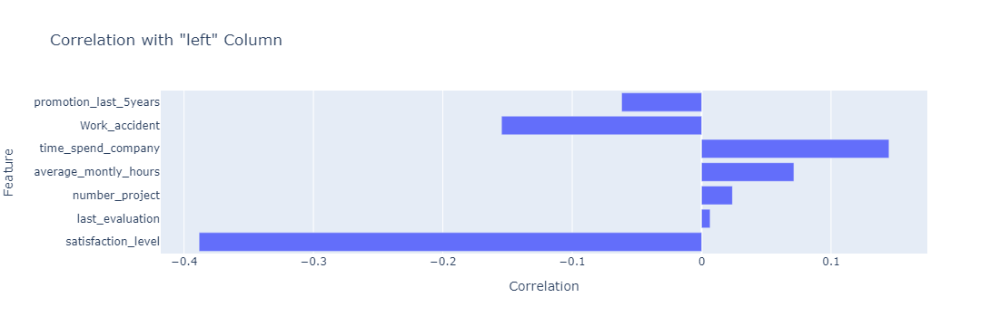

In [ ]:

# Select only numeric columns
numeric_columns = df.select_dtypes(include='number')

# Calculate the correlation with the 'left' column and drop 'left' itself
correlation_with_left = numeric_columns.corr()['left'].drop('left')

# Create a DataFrame from the correlation Series
correlation_df = correlation_with_left.reset_index().rename(columns={'index': 'Feature', 'left': 'Correlation'})

# Plot the horizontal bar chart using Plotly Express
fig = px.bar(correlation_df, x='Correlation', y='Feature', orientation='h', title='Correlation with "left" Column')
fig.show()



For satisfaction_level and satisfaction_level, there is NO multicollinearity problem
For satisfaction_level and last_evaluation, there is NO multicollinearity problem
For satisfaction_level and number_project, there is NO multicollinearity problem
For satisfaction_level and average_montly_hours, there is NO multicollinearity problem
For satisfaction_level and time_spend_company, there is NO multicollinearity problem
For satisfaction_level and Work_accident, there is NO multicollinearity problem
For satisfaction_level and left, there is NO multicollinearity problem
For satisfaction_level and promotion_last_5years, there is NO multicollinearity problem
For last_evaluation and satisfaction_level, there is NO multicollinearity problem
For last_evaluation and last_evaluation, there is NO multicollinearity problem
For last_evaluation and number_project, there is NO multicollinearity problem
For last_evaluation and average_montly_hours, there is NO multicollinearity problem
For last_evaluatio

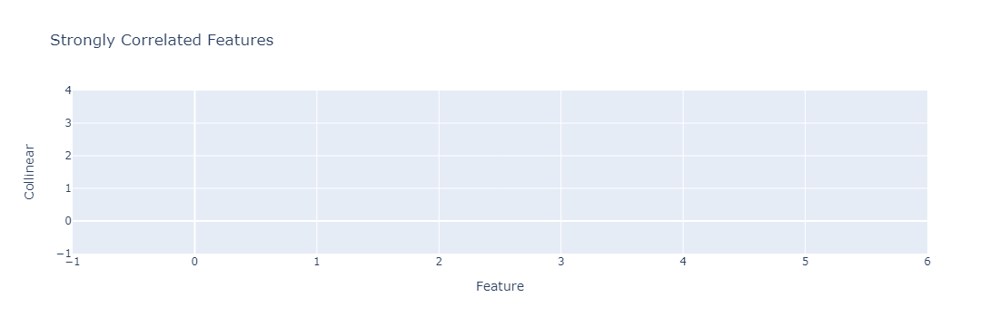

In [ ]:
import pandas as pd
import plotly.express as px

# Check if there are any non-numeric columns and remove them
numeric_columns = df.select_dtypes(include=['float64', 'int64'])

# Check if there are any missing values in numeric columns
if numeric_columns.isnull().values.any():
    # Handle missing values (e.g., impute or remove)
    numeric_columns = numeric_columns.dropna()

# Check if there are any numeric columns left
if not numeric_columns.empty:
    # Calculate the correlation matrix
    df_temp = numeric_columns.corr()

    # Initialize variables
    count = 0
    feature = []
    collinear = []

    # Set the correlation threshold
    threshold = 0.9

    # Check for highly correlated features
    for col in df_temp.columns:
        for i in df_temp.index:
            if col != i and ((df_temp[col][i] > 0.9 and df_temp[col][i] < 1) or (df_temp[col][i] < -0.9 and df_temp[col][i] > -1)):
                count += 1
                feature.append(col)
                collinear.append(i)
                print(f"\033[1mMulticollinearity alert between\033[0m {col} - {i} - Correlation: {df_temp[col][i]}")
            else:
                print(f'For {col} and {i}, there is NO multicollinearity problem')

    print('\033[1mThe number of strongly correlated features:\033[0m', count)

    # Create a DataFrame for strongly correlated features
    correlation_data = {'Feature': feature, 'Collinear': collinear}
    correlation_df = pd.DataFrame(correlation_data)

    # Plot the strongly correlated features
    fig = px.scatter(correlation_df, x='Feature', y='Collinear', title='Strongly Correlated Features')
    fig.show()
else:
    print("There are no numeric columns in the DataFrame or all numeric columns have missing values.")


## 2. Data Pre-Processing

- Scaling
- Label Encoding
----------

#### Label Encoding

Lots of machine learning algorithms require numerical input data, so you need to represent categorical columns in a numerical column. In order to encode this data, you could map each value to a number. e.g. Salary column's value can be represented as low:0, medium:1, and high:2. This process is known as label encoding, and sklearn conveniently will do this for you using LabelEncoder.



In [ ]:
cprint('New df for Kmeans clustering','green')
df1 = df.drop('left', axis = 1)
df1.head(1)

New df for Kmeans clustering


,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,promotion_last_5years,Departments,salary
0,0.38,0.53,2,157,3,0,0,sales,low


In [ ]:
# Remove extra space from column name
df1.rename(columns={'Departments ': 'Departments'}, inplace=True)

# Apply pd.get_dummies() again
df1 = pd.get_dummies(df1, columns=['Departments', 'salary'], drop_first=True)


#### Scaling
    

In [ ]:
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,promotion_last_5years,Departments_RandD,Departments_accounting,Departments_hr,Departments_management,Departments_marketing,Departments_product_mng,Departments_sales,Departments_support,Departments_technical,salary_low,salary_medium
0,0.38,0.53,2,157,3,0,0,False,False,False,False,False,False,True,False,False,True,False
1,0.80,0.86,5,262,6,0,0,False,False,False,False,False,False,True,False,False,False,True
2,0.11,0.88,7,272,4,0,0,False,False,False,False,False,False,True,False,False,False,True
3,0.72,0.87,5,223,5,0,0,False,False,False,False,False,False,True,False,False,True,False
4,0.37,0.52,2,159,3,0,0,False,False,False,False,False,False,True,False,False,True,False


In [ ]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(df1)
df1_scaled = scaler.transform(df1)


In [ ]:
df1_scaled

array([[0.31868132, 0.265625  , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.78021978, 0.78125   , 0.6       , ..., 0.        , 0.        ,
        1.        ],
       [0.02197802, 0.8125    , 1.        , ..., 0.        , 0.        ,
        1.        ],
       ...,
       [0.30769231, 0.265625  , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.02197802, 0.9375    , 0.8       , ..., 0.        , 1.        ,
        0.        ],
       [0.30769231, 0.25      , 0.        , ..., 0.        , 1.        ,
        0.        ]])

***Based on the examinations made above,***

- There is no multicollinearity problem among the features.
- We have weak level correlation between the numerical features and the target column.
- Also there is weak level correlation between the columns.
- Target variable demonstrates a slight negative correlation with the variables of "creditscore", "tenure", "numberofproducts" 'hascrcard' and 'isactivemember', 
- Target variable demonstrates slight positive correlation with the variables of 'age', 'balance' and 'estimatedsalary".
- Age has more influence on the decision to leave the bank than the other columns.
- It is noteworthy that those who left the bank are in the 45-65 age group. 
- The increase in the number of products negatively affects the decision to continue with the bank.
- Another remarkable situation is the concentration of leaving the bank in the group where the number of products is 3 and 4. 

## 3. Data Visualization

- Employees Left
- Determine Number of Projects
- Determine Time Spent in Company
- Subplots of Features
----------
You can search for answers to the following questions using data visualization methods. Based on these responses, you can develop comments about the factors that cause churn.

- How does the promotion status affect employee churn?
- How does years of experience affect employee churn?
- How does workload affect employee churn?
- How does the salary level affect employee churn?



- Determine Number of Projects
- Determine Time Spent in Company
- Subplots of Features
----------
You can search for answers to the following questions using data visualization methods. Based on these responses, you can develop comments about the factors that cause churn.

- How does the promotion status affect employee churn?
- How does years of experience affect employee churn?
- How does workload affect employee churn?
- How does the salary level affect employee churn?



### Employees Left

Let's check how many employees were left?
Here, you can plot a bar graph using Matplotlib. The bar graph is suitable for showing discrete variable counts.

In [ ]:
cprint('"left" Column Distribution','green')
df.left.value_counts()

"left" Column Distribution


left
0    11428
1     3571
Name: count, dtype: int64

"left" Column Distribution


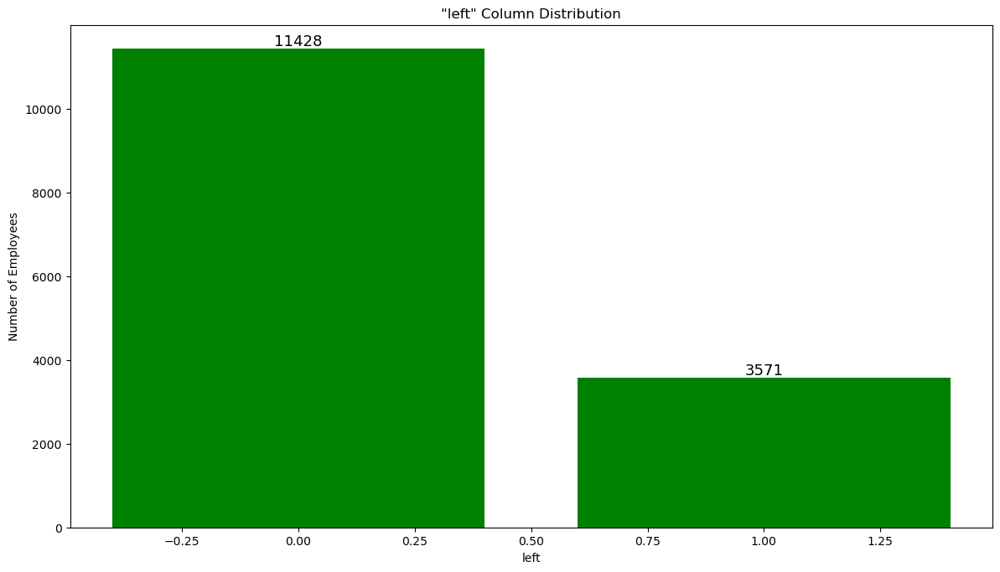

In [ ]:
cprint('"left" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
ax.bar(df.left.value_counts().index, df.left.value_counts().values, color = 'green')
plt.title('"left" Column Distribution')   
plt.xlabel('left') 
plt.ylabel('Number of Employees') 
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### Number of Projects

Similarly, you can also plot a bar graph to count the number of employees deployed on how many projects?

In [ ]:
cprint('"number_project" Column Distribution','green')
df.number_project.value_counts()

"number_project" Column Distribution


number_project
4    4365
3    4055
5    2761
2    2388
6    1174
7     256
Name: count, dtype: int64

"number_project" Column Distribution


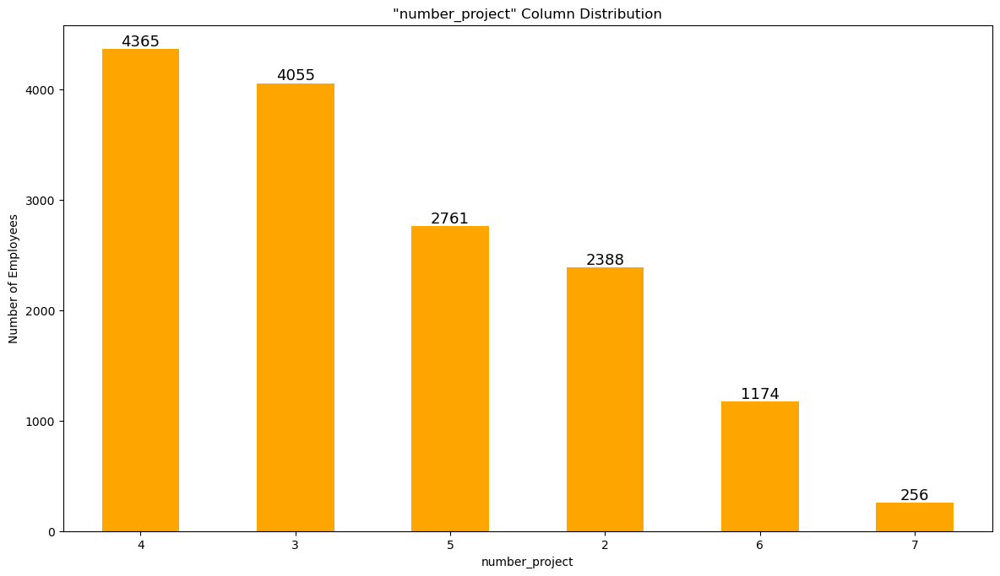

In [ ]:
cprint('"number_project" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
df.number_project.value_counts().plot(kind = "bar", color = "orange")
plt.title('"number_project" Column Distribution')   
plt.xlabel('number_project') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.number_project.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### Time Spent in Company

Similarly, you can also plot a bar graph to count the number of employees have based on how much experience?


In [ ]:
cprint('"time_spend_company" Column Distribution','green')
df.time_spend_company.value_counts()

"time_spend_company" Column Distribution


time_spend_company
3     6443
2     3244
4     2557
5     1473
6      718
10     214
7      188
8      162
Name: count, dtype: int64

"time_spend_company" Column Distribution


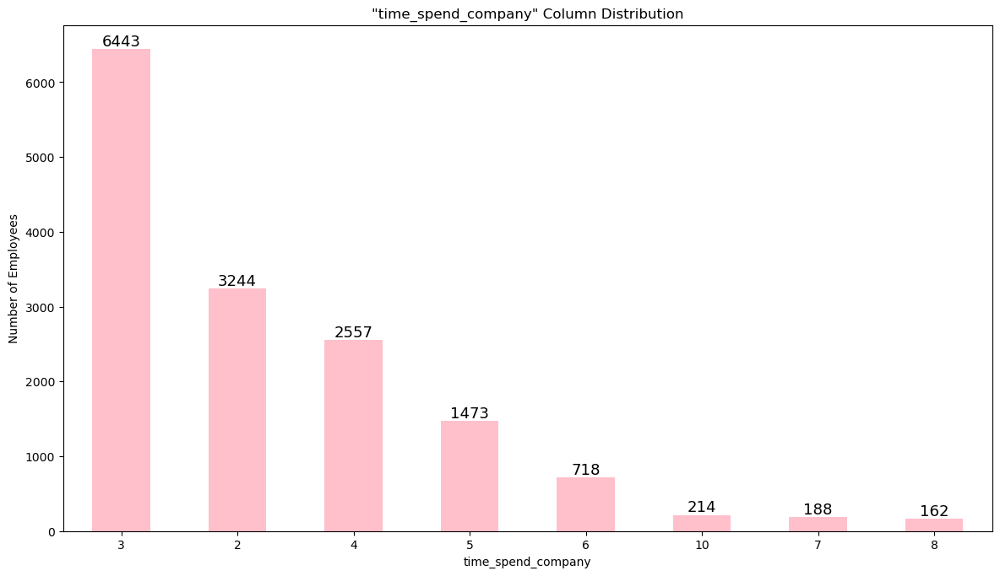

In [ ]:
cprint('"time_spend_company" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
df.time_spend_company.value_counts().plot(kind = "bar", color = "pink")
plt.title('"time_spend_company" Column Distribution')   
plt.xlabel('time_spend_company') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.time_spend_company.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### Subplots of Features

You can use the methods of the matplotlib.

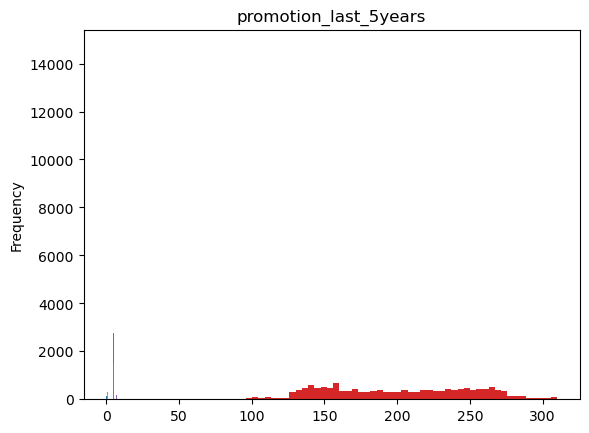

In [ ]:
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

for column in numeric_columns:
    df[column].plot(kind='hist', bins=50, title=column)


In [ ]:
df.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident', 'left',
       'promotion_last_5years', 'Departments ', 'salary'],
      dtype='object')

## 4. Cluster Analysis

- Find the optimal number of clusters (k) using the elbow method for for K-means.
- Determine the clusters by using K-Means then Evaluate predicted results.
---------

- Cluster analysis or clustering is the task of grouping a set of objects in such a way that objects in the same group (called a cluster) are more similar (in some sense) to each other than to those in other groups (clusters). It is a main task of exploratory data mining, and a common technique for statistical data analysis, used in many fields, including pattern recognition, image analysis, information retrieval, bioinformatics, data compression, computer graphics and machine learning.

#### The Elbow Method

- "Elbow Method" can be used to find the optimum number of clusters in cluster analysis. The elbow method is used to determine the optimal number of clusters in k-means clustering. The elbow method plots the value of the cost function produced by different values of k. If k increases, average distortion will decrease, each cluster will have fewer constituent instances, and the instances will be closer to their respective centroids. However, the improvements in average distortion will decline as k increases. The value of k at which improvement in distortion declines the most is called the elbow, at which we should stop dividing the data into further clusters.

In [ ]:
from sklearn.neighbors import NearestNeighbors
import numpy as np

# Define a function to calculate the Hopkins statistic
def hopkins(X, n):
    # Initialize a nearest neighbors model
    nbrs = NearestNeighbors(n_neighbors=1).fit(X)
    
    # Generate random points
    random_points = np.random.rand(n, X.shape[1])
    
    # Calculate distances to nearest neighbors for both real and random points
    real_distances, _ = nbrs.kneighbors(X)
    random_distances, _ = nbrs.kneighbors(random_points)
    
    # Calculate the Hopkins statistic
    hopkins_statistic = np.sum(random_distances) / (np.sum(random_distances) + np.sum(real_distances))
    
    return hopkins_statistic

# Calculate the Hopkins statistic for the scaled data
hopkins_statistic = hopkins(df1_scaled, df1_scaled.shape[0])
print("Hopkins statistic:", hopkins_statistic)


Hopkins statistic: 0.9999999966227942


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will chang

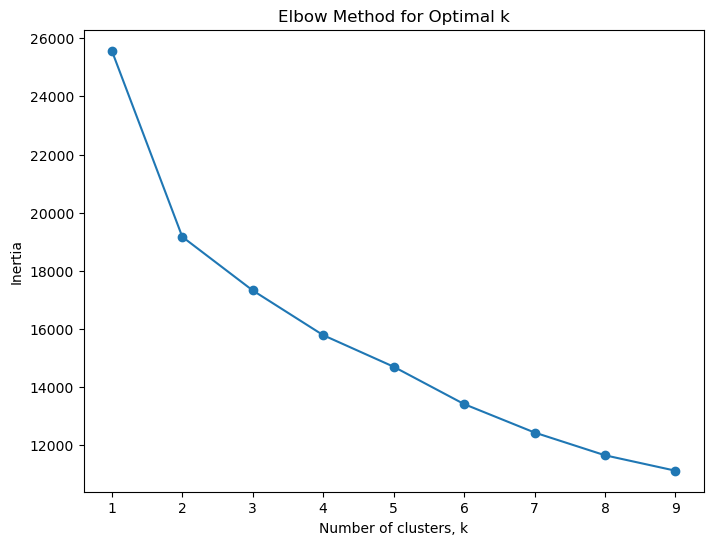

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Define the range of clusters
ks = range(1, 10)

# Initialize an empty list to store inertias
inertias = []

# Calculate inertia for each k
for k in ks:
    # Create a KMeans cluster
    kc = KMeans(n_clusters=k, random_state=1)
    kc.fit(df1_scaled)
    
    # Append the inertia to the list
    inertias.append(kc.inertia_)

# Plot ks vs inertias
plt.figure(figsize=(8, 6))
plt.plot(ks, inertias, '-o')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.xticks(ks)
plt.title('Elbow Method for Optimal k')
plt.show()


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will chang

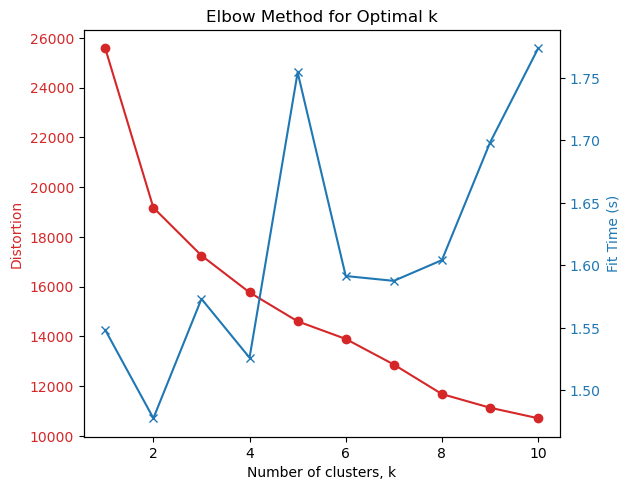

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import time

# Define the range of clusters
k_range = range(1, 11)

# Initialize KMeans
kmeans = KMeans()

# Lists to store distortions and fit times
distortions = []
fit_times = []

# Calculate distortion score and fit time for each k
for k in k_range:
    start_time = time.time()
    kmeans.set_params(n_clusters=k)
    kmeans.fit(df1_scaled)
    fit_times.append(time.time() - start_time)
    distortions.append(kmeans.inertia_)

# Plot the elbow curve
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('Number of clusters, k')
ax1.set_ylabel('Distortion', color=color)
ax1.plot(k_range, distortions, marker='o', color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  
color = 'tab:blue'
ax2.set_ylabel('Fit Time (s)', color=color)  
ax2.plot(k_range, fit_times, marker='x', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  
plt.title('Elbow Method for Optimal k')
plt.show()


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

ssd = []
silhouette_scores = []

K = range(2, 10)

for k in K:
    model = KMeans(n_clusters=k)
    model.fit(df1_scaled)
    ssd.append(model.inertia_)
    silhouette = silhouette_score(df1_scaled, model.labels_)
    silhouette_scores.append(silhouette)
    print(f'Silhouette Score for {k} clusters: {silhouette}')


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 2 clusters: 0.24094786639289728


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 3 clusters: 0.19188598184865385


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 4 clusters: 0.17989911831305486


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 5 clusters: 0.2091151592978723


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 6 clusters: 0.23985593812597766


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 7 clusters: 0.2458412557226587


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 8 clusters: 0.268072246898104


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for 9 clusters: 0.30041069584791313


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



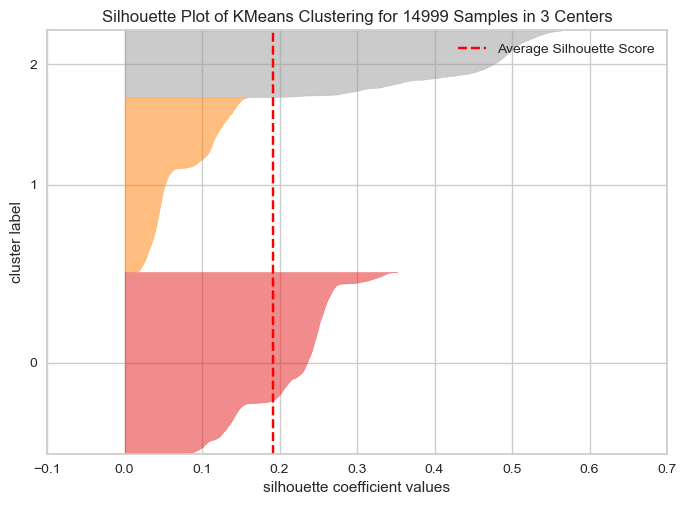

In [ ]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer

model_3 = KMeans(n_clusters=3, random_state=101)
visualizer = SilhouetteVisualizer(model_3)
visualizer.fit(df1_scaled)
visualizer.show()


C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



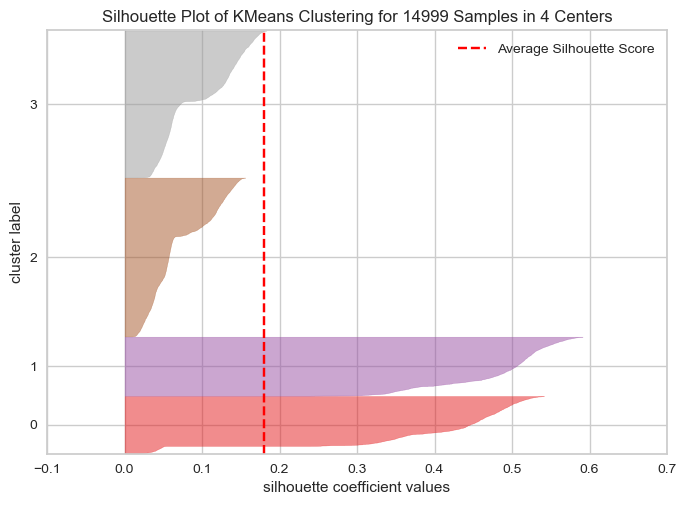

In [ ]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

model_4 = KMeans(n_clusters = 4, random_state = 101)
visualizer = SilhouetteVisualizer(model_4)
visualizer.fit(df1_scaled)    # Fit the data to the visualizer
visualizer.poof();

According to the silhouette score, clustering according to the K=3 and K=4 are seen above. For K=3, clustering is better. According to the Elbow method, the best K=3. Therefore, it will be continued as K=3.

In [ ]:
k_means_model = KMeans(n_clusters = 3, random_state = 101)
k_means_model.fit_predict(df1_scaled)
labels = k_means_model.labels_
labels

C:\Users\HP\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



array([2, 0, 0, ..., 1, 1, 1])

In [ ]:
df['predicted_clusters'] = labels
df

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary,predicted_clusters
0,0.38,0.53,2,157,3,0,1,0,sales,low,2
1,0.80,0.86,5,262,6,0,1,0,sales,medium,0
2,0.11,0.88,7,272,4,0,1,0,sales,medium,0
3,0.72,0.87,5,223,5,0,1,0,sales,low,2
4,0.37,0.52,2,159,3,0,1,0,sales,low,2
...,...,...,...,...,...,...,...,...,...,...,...
14994,0.40,0.57,2,151,3,0,1,0,support,low,1
14995,0.37,0.48,2,160,3,0,1,0,support,low,1
14996,0.37,0.53,2,143,3,0,1,0,support,low,1
14997,0.11,0.96,6,280,4,0,1,0,support,low,1


In [ ]:
cprint('"predicted_clusters" value counts','green')
df['predicted_clusters'].value_counts()

"predicted_clusters" value counts


predicted_clusters
0    6446
1    6185
2    2368
Name: count, dtype: int64

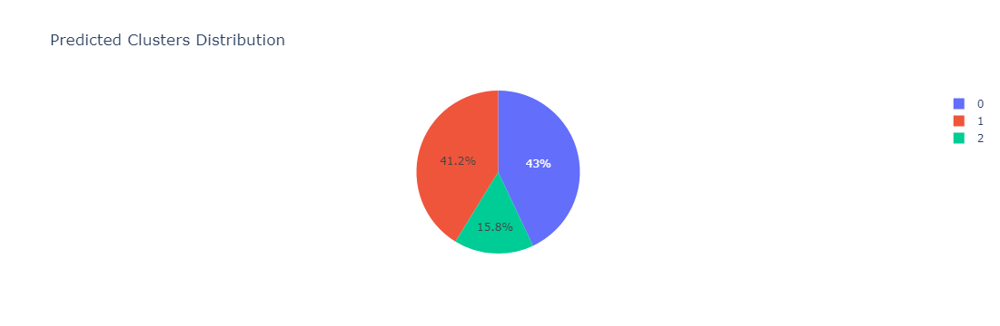

In [ ]:
# Get the value counts of predicted_clusters
cluster_counts = df['predicted_clusters'].value_counts()

# Create the pie chart
fig = px.pie(values=cluster_counts, 
             names=cluster_counts.index, 
             title='Predicted Clusters Distribution')

# Show the pie chart
fig.show()


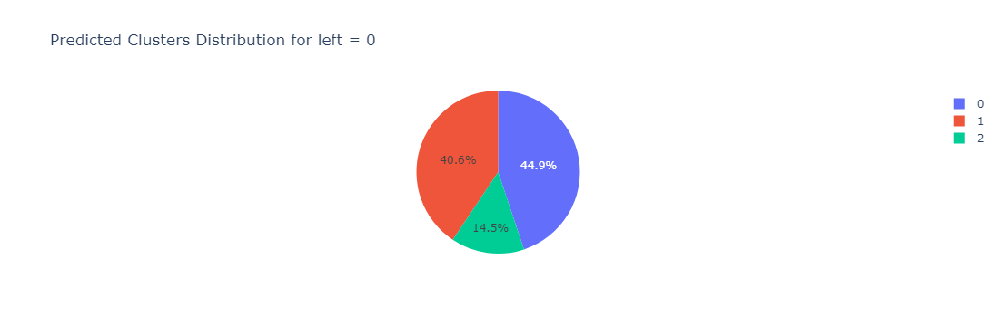

In [ ]:
# Filter the DataFrame where 'left' is 0 and get value counts of predicted_clusters
cluster_counts_left_0 = df[df['left'] == 0]['predicted_clusters'].value_counts()

# Create the pie chart
fig = px.pie(values=cluster_counts_left_0.values, 
             names=cluster_counts_left_0.index, 
             title='Predicted Clusters Distribution for left = 0')

# Show the pie chart
fig.show()


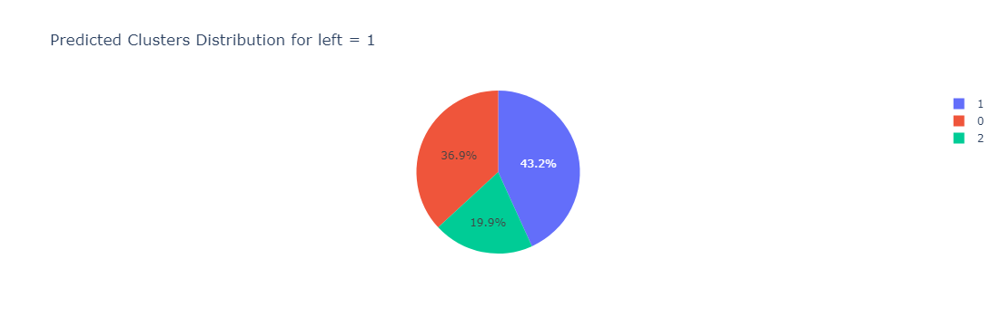

In [ ]:
# Filter the DataFrame where 'left' is 1 and get value counts of predicted_clusters
cluster_counts_left_1 = df[df['left'] == 1]['predicted_clusters'].value_counts()

# Create the pie chart
fig = px.pie(values=cluster_counts_left_1.values, 
             names=cluster_counts_left_1.index, 
             title='Predicted Clusters Distribution for left = 1')

# Show the pie chart
fig.show()


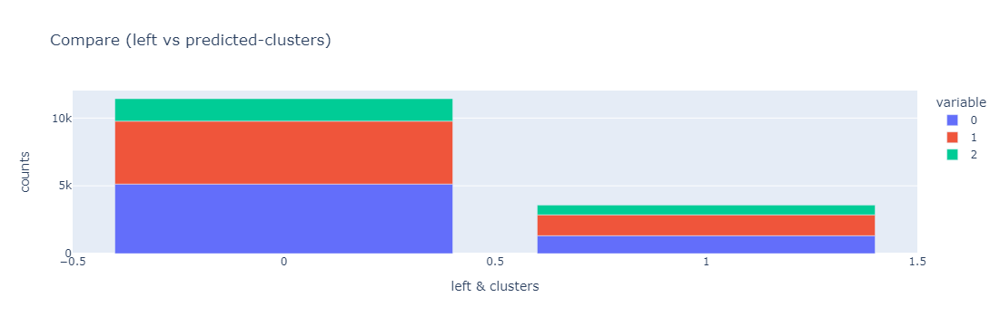

In [ ]:
# Create a cross-tabulation between 'left' and 'predicted_clusters'
cross_tab = pd.crosstab(df['left'], df['predicted_clusters'])

# Reshape the DataFrame
cross_tab.reset_index(inplace=True)

# Plot the cross-tabulation as a bar graph
fig = px.bar(cross_tab, 
             x='left', 
             y=cross_tab.columns[1:], 
             title='Compare (left vs predicted-clusters)',
             labels={'left': 'left & clusters', 'value': 'counts'})

# Show the plot
fig.show()


In [ ]:
# Filter out non-numeric columns
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

# Calculate the mean values according to the 'left' column
mean_values = df.groupby('left')[numeric_columns].mean()

# Print the mean values
print(mean_values)


      satisfaction_level  last_evaluation  number_project  \
left                                                        
0               0.666810         0.715473        3.786664   
1               0.440098         0.718113        3.855503   

      average_montly_hours  time_spend_company  Work_accident  left  \
left                                                                  
0               199.060203            3.380032       0.175009   0.0   
1               207.419210            3.876505       0.047326   1.0   

      promotion_last_5years  
left                         
0                  0.026251  
1                  0.005321  


In [ ]:
# Filter out non-numeric columns
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

# Calculate the mean values according to the 'left' and 'predicted_clusters' columns
mean_values = df.groupby(['left', 'predicted_clusters'])[numeric_columns].mean()

# Print the mean values
print(mean_values)


                         satisfaction_level  last_evaluation  number_project  \
left predicted_clusters                                                        
0    0                             0.668875         0.715461        3.788068   
     1                             0.664128         0.718880        3.785653   
     2                             0.667930         0.705969        3.785154   
1    0                             0.438550         0.724571        3.912680   
     1                             0.431011         0.714809        3.863253   
     2                             0.462686         0.713319        3.732771   

                         average_montly_hours  time_spend_company  \
left predicted_clusters                                             
0    0                             199.214272            3.435952   
     1                             199.049117            3.341017   
     2                             198.614363            3.316234   
1    0        

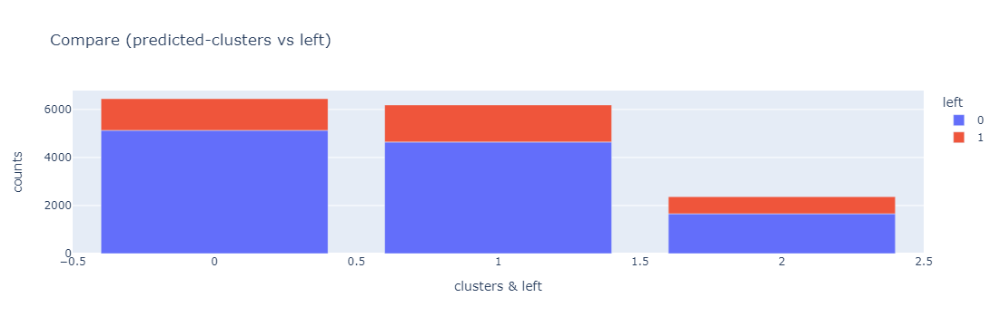

In [ ]:
# Create a cross-tabulation of 'predicted_clusters' and 'left'
cross_tab = pd.crosstab(df['predicted_clusters'], df['left'])

# Plot the cross-tabulation as a bar graph
fig = px.bar(cross_tab, 
             x=cross_tab.index, 
             y=cross_tab.columns, 
             title='Compare (predicted-clusters vs left)',
             labels={'predicted_clusters': 'clusters & left', 'value': 'counts'})

# Show the plot
fig.show()


In [ ]:
# Filter numeric columns
numeric_columns = df.select_dtypes(include=['int64', 'float64'])

# Calculate the mean values according to the predicted clusters
mean_values = df.groupby('predicted_clusters')[numeric_columns.columns].mean()

# Print the mean values
print(mean_values)


                    satisfaction_level  last_evaluation  number_project  \
predicted_clusters                                                        
0                             0.621817         0.717322        3.813528   
1                             0.605971         0.717864        3.805012   
2                             0.606305         0.708176        3.769426   

                    average_montly_hours  time_spend_company  Work_accident  \
predicted_clusters                                                            
0                             201.338349            3.529010       0.145361   
1                             200.977850            3.475505       0.150364   
2                             200.455659            3.473818       0.127534   

                        left  promotion_last_5years  
predicted_clusters                                   
0                   0.204313               0.028079  
1                   0.249475               0.017138  
2           

In [ ]:
# Filter numeric columns
numeric_columns = df.select_dtypes(include=['int64', 'float64'])

# Calculate the mean values according to the predicted clusters and left
mean_values = df.groupby(['predicted_clusters', 'left'])[numeric_columns.columns].mean()

# Print the mean values
print(mean_values)


                         satisfaction_level  last_evaluation  number_project  \
predicted_clusters left                                                        
0                  0               0.668875         0.715461        3.788068   
                   1               0.438550         0.724571        3.912680   
1                  0               0.664128         0.718880        3.785653   
                   1               0.431011         0.714809        3.863253   
2                  0               0.667930         0.705969        3.785154   
                   1               0.462686         0.713319        3.732771   

                         average_montly_hours  time_spend_company  \
predicted_clusters left                                             
0                  0               199.214272            3.435952   
                   1               209.610478            3.891420   
1                  0               199.049117            3.341017   
              

In [ ]:
# Select numeric columns
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

# Group by 'predicted_clusters' and calculate mean for numeric columns
clus_pred = df.groupby("predicted_clusters")[numeric_columns].mean().T

# Display the resulting DataFrame
print(clus_pred)


predicted_clusters              0           1           2
satisfaction_level       0.621817    0.605971    0.606305
last_evaluation          0.717322    0.717864    0.708176
number_project           3.813528    3.805012    3.769426
average_montly_hours   201.338349  200.977850  200.455659
time_spend_company       3.529010    3.475505    3.473818
Work_accident            0.145361    0.150364    0.127534
left                     0.204313    0.249475    0.300253
promotion_last_5years    0.028079    0.017138    0.013514


C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



<Axes: >

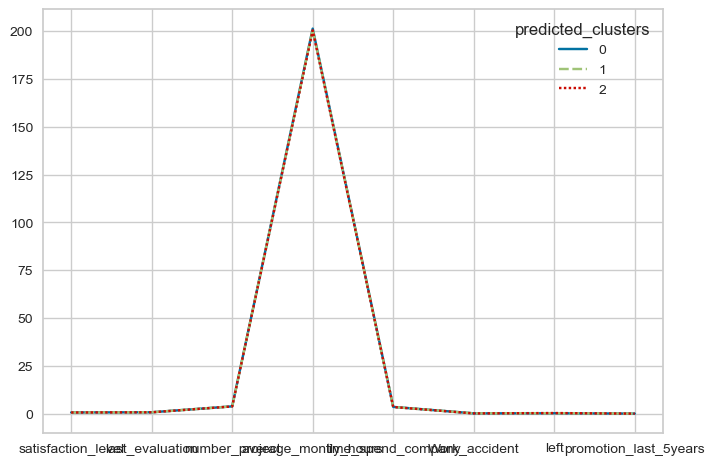

In [ ]:
# Drop non-numeric columns
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns
grouped_data = df.groupby("predicted_clusters")[numeric_columns].mean().T

# Plot the grouped data using a line plot
sns.lineplot(data=grouped_data)


## 5. Model Building

- Split Data as Train and Test set
- Built K Neighbors Classifier and Evaluate Model Performance and Predict Test Data
---------

#### Evaluating Model Performance

### Split Data as Train and Test Set

Here, Dataset is broken into two parts in ratio of 70:30. It means 70% data will used for model training and 30% for model testing.

In [ ]:
cprint('New df for Classification','green')
df2 = df.drop('predicted_clusters', axis = 1)
df2.head(1)

New df for Classification


,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low


In [ ]:
# Remove leading and trailing whitespace and newline characters from column names
df2.columns = df2.columns.str.strip()

# Get dummies for specified columns with prefix
df2 = pd.get_dummies(df2, drop_first=True)

# Display the first row of the new DataFrame
print(df2.head(1))


   satisfaction_level  last_evaluation  number_project  average_montly_hours  \
0                0.38             0.53               2                   157   

   time_spend_company  Work_accident  left  promotion_last_5years  \
0                   3              0     1                      0   

   department_RandD_True  department_accounting_True  department_hr_True  \
0                  False                       False               False   

   department_management_True  department_marketing_True  \
0                       False                      False   

   department_product_mng_True  department_sales_True  \
0                        False                   True   

   department_support_True  department_technical_True  salary_low_True  \
0                    False                      False             True   

   salary_medium_True  
0               False  


In [ ]:
X = df2.drop('left', axis = 1)
y = df2['left']

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.3, random_state=101)


In [ ]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [ ]:
def eval(model, X_train, X_test):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    
    print(confusion_matrix(y_test, y_pred))
    print("Test_Set")
    print(classification_report(y_test,y_pred))
    print("Train_Set")
    print(classification_report(y_train,y_pred_train))
    plot_confusion_matrix(model, X_test, y_test, cmap="plasma")

In [ ]:
def train_val(y_train, y_train_pred, y_test, y_pred):
    
    scores = {"train_set": {"Accuracy" : accuracy_score(y_train, y_train_pred),
                            "Precision" : precision_score(y_train, y_train_pred),
                            "Recall" : recall_score(y_train, y_train_pred),                          
                            "f1" : f1_score(y_train, y_train_pred)},
    
              "test_set": {"Accuracy" : accuracy_score(y_test, y_pred),
                           "Precision" : precision_score(y_test, y_pred),
                           "Recall" : recall_score(y_test, y_pred),                          
                           "f1" : f1_score(y_test, y_pred)}}
    
    return pd.DataFrame(scores)

#### Model Building

### KNeighbors Classifier

#### Model Building

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score, accuracy_score, recall_score, roc_auc_score

KNN_model = KNeighborsClassifier(n_neighbors=5)
KNN_model.fit(X_train, y_train)
y_pred = KNN_model.predict(X_test)
y_train_pred = KNN_model.predict(X_train)

KNN_model_f1 = f1_score(y_test, y_pred)
KNN_model_acc = accuracy_score(y_test, y_pred)
KNN_model_recall = recall_score(y_test, y_pred)
KNN_model_auc = roc_auc_score(y_test, y_pred)


#### Evaluating Model Performance

KNN_Model
------------------
[[3259  170]
 [ 108  963]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.95      0.96      3429
           1       0.85      0.90      0.87      1071

    accuracy                           0.94      4500
   macro avg       0.91      0.92      0.92      4500
weighted avg       0.94      0.94      0.94      4500

Train_Set
              precision    recall  f1-score   support

           0       0.98      0.97      0.97      7999
           1       0.91      0.93      0.92      2500

    accuracy                           0.96     10499
   macro avg       0.94      0.95      0.95     10499
weighted avg       0.96      0.96      0.96     10499



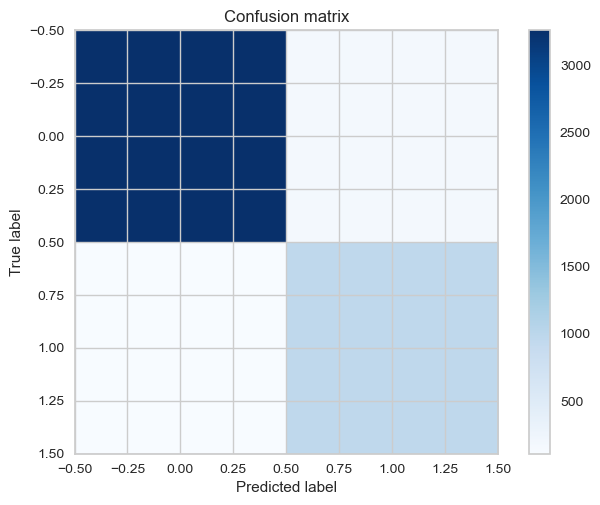

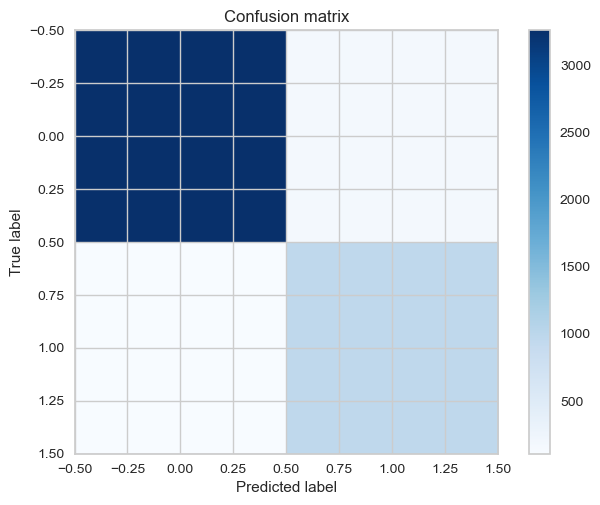

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, classification_report

def plot_confusion_matrix(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title('Confusion matrix')
    plt.colorbar()
    plt.xlabel('Predicted label')
    plt.ylabel('True label')
    plt.show()

print("KNN_Model")
print("------------------")
eval(KNN_model, X_train, X_test)

def eval(model, X_train, X_test):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    print(confusion_matrix(y_test, y_pred))
    print("Test_Set")
    print(classification_report(y_test,y_pred))


# Call plot_confusion_matrix with your y_true and y_pred
plot_confusion_matrix(y_test, y_pred)


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report

def train_val(y_train, y_train_pred, y_test, y_pred):
    print("Training Set:")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

    print("Test Set:")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))

# Call the function with your training and testing data
train_val(y_train, y_train_pred, y_test, y_pred)


Training Set:
[[7763  236]
 [ 169 2331]]
              precision    recall  f1-score   support

           0       0.98      0.97      0.97      7999
           1       0.91      0.93      0.92      2500

    accuracy                           0.96     10499
   macro avg       0.94      0.95      0.95     10499
weighted avg       0.96      0.96      0.96     10499

Test Set:
[[3259  170]
 [ 108  963]]
              precision    recall  f1-score   support

           0       0.97      0.95      0.96      3429
           1       0.85      0.90      0.87      1071

    accuracy                           0.94      4500
   macro avg       0.91      0.92      0.92      4500
weighted avg       0.94      0.94      0.94      4500



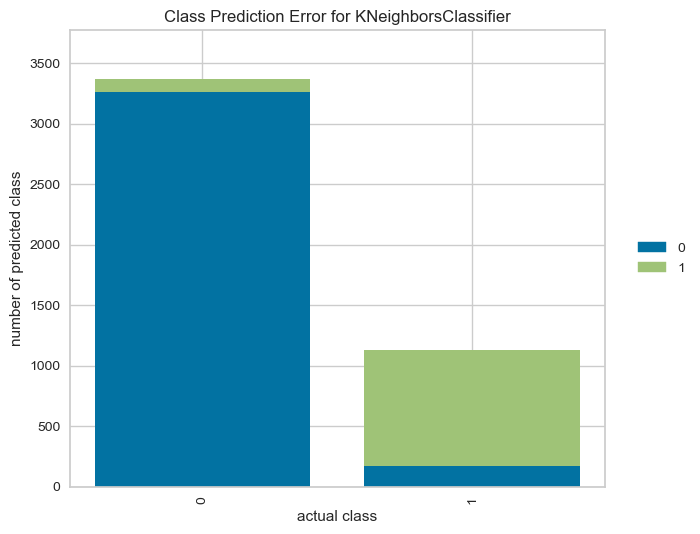

In [ ]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(KNN_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

#### KNeighbors Classifier Cross Validation

In [ ]:
from sklearn.model_selection import cross_validate
import pandas as pd
from sklearn.neighbors import KNeighborsClassifier

KNN_cv = KNeighborsClassifier(n_neighbors=5)

KNN_cv_scores = cross_validate(KNN_cv, X_train, y_train, 
                                scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'], cv=10)
KNN_cv_scores = pd.DataFrame(KNN_cv_scores, index=range(1, 11))

KNN_cv_scores.mean()[2:]


test_accuracy     0.937613
test_precision    0.862000
test_recall       0.880000
test_f1           0.870478
test_roc_auc      0.968124
dtype: float64

#### Elbow Method for Choosing Reasonable K Values

[0.037555555555555564, 0.04133333333333333, 0.05266666666666664, 0.05466666666666664, 0.06177777777777782, 0.055333333333333345, 0.059555555555555584, 0.058666666666666645, 0.06355555555555559, 0.06333333333333335, 0.06822222222222218, 0.06622222222222218, 0.06911111111111112, 0.06666666666666665, 0.06999999999999995, 0.06977777777777783, 0.07199999999999995, 0.07422222222222219, 0.0775555555555556, 0.07866666666666666, 0.08133333333333337, 0.08266666666666667, 0.0862222222222222, 0.0868888888888889, 0.08933333333333338, 0.09133333333333338, 0.09266666666666667, 0.09133333333333338, 0.09244444444444444]


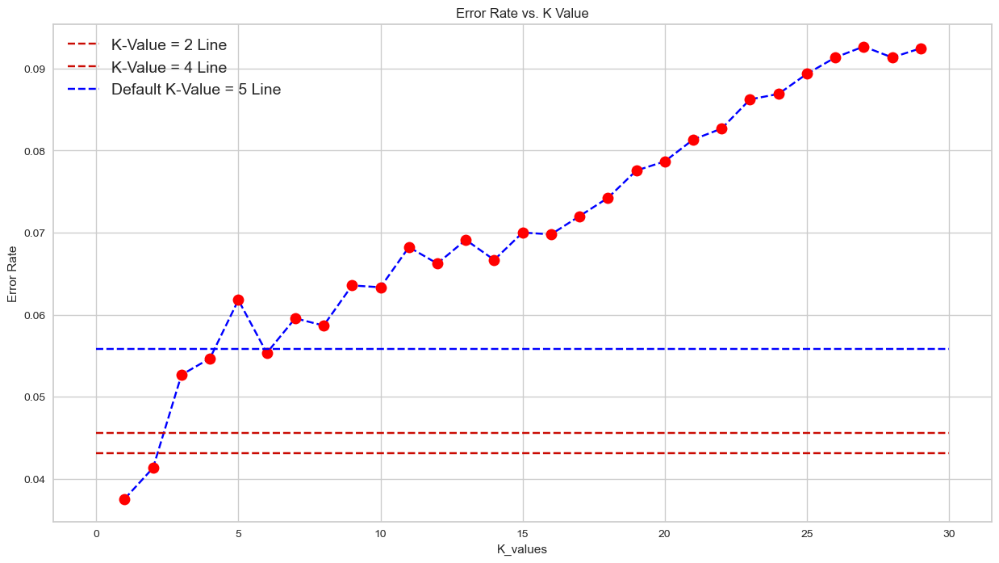

In [ ]:
test_error_rates = []

for k in range(1, 30):
    KNN = KNeighborsClassifier(n_neighbors = k)
    KNN.fit(X_train, y_train) 
   
    y_pred = KNN.predict(X_test)
    
    test_error = 1 - accuracy_score(y_test, y_pred)
    test_error_rates.append(test_error)
    
print(test_error_rates)

plt.figure(figsize = (15, 8))
plt.plot(range(1, 30), test_error_rates, color = 'blue', linestyle = '--', marker = 'o',
         markerfacecolor = 'red', markersize = 10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K_values')
plt.ylabel('Error Rate')

plt.hlines(y = 0.04307948860478039, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 2 Line")
plt.hlines(y = 0.04558087826570312, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 4 Line")
plt.hlines(y = 0.055864369093941, xmin = 0, xmax = 30, colors = 'blue', linestyles = "--", label = "Default K-Value = 5 Line")
plt.legend(prop = {"size":14});

Let's have look to recall values for differen K's ranging from 1 to 10

In [ ]:
# FIRST A QUICK COMPARISON TO OUR DEFAULT K=5

knn5 = KNeighborsClassifier(n_neighbors = 5)

knn5.fit(X_train,y_train)
pred = knn5.predict(X_test)

print('WITH K=5')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=5
---------------
[[3259  170]
 [ 108  963]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.95      0.96      3429
           1       0.85      0.90      0.87      1071

    accuracy                           0.94      4500
   macro avg       0.91      0.92      0.92      4500
weighted avg       0.94      0.94      0.94      4500



In [ ]:
# NOW K=2

knn2 = KNeighborsClassifier(n_neighbors = 2)

knn2.fit(X_train,y_train)
pred = knn2.predict(X_test)

print('WITH K=2')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=2
---------------
[[3350   79]
 [ 107  964]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3429
           1       0.92      0.90      0.91      1071

    accuracy                           0.96      4500
   macro avg       0.95      0.94      0.94      4500
weighted avg       0.96      0.96      0.96      4500



In [ ]:
# NOW K=4

knn4 = KNeighborsClassifier(n_neighbors = 4)

knn4.fit(X_train,y_train)
pred = knn4.predict(X_test)

print('WITH K=4')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=4
---------------
[[3299  130]
 [ 116  955]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.96      0.96      3429
           1       0.88      0.89      0.89      1071

    accuracy                           0.95      4500
   macro avg       0.92      0.93      0.92      4500
weighted avg       0.95      0.95      0.95      4500



In [ ]:
# NOW K=6

knn6 = KNeighborsClassifier(n_neighbors = 6)

knn6.fit(X_train,y_train)
pred = knn6.predict(X_test)

print('WITH K=6')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=6
---------------
[[3303  126]
 [ 123  948]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.96      0.96      3429
           1       0.88      0.89      0.88      1071

    accuracy                           0.94      4500
   macro avg       0.92      0.92      0.92      4500
weighted avg       0.94      0.94      0.94      4500



In [ ]:
# NOW K=8

knn8 = KNeighborsClassifier(n_neighbors = 8)

knn8.fit(X_train,y_train)
pred = knn8.predict(X_test)

print('WITH K=8')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=8
---------------
[[3297  132]
 [ 132  939]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.96      0.96      3429
           1       0.88      0.88      0.88      1071

    accuracy                           0.94      4500
   macro avg       0.92      0.92      0.92      4500
weighted avg       0.94      0.94      0.94      4500



In [ ]:
# NOW K=10

knn10 = KNeighborsClassifier(n_neighbors = 10)

knn10.fit(X_train,y_train)
pred = knn10.predict(X_test)

print('WITH K=10')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=10
---------------
[[3278  151]
 [ 134  937]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.96      0.96      3429
           1       0.86      0.87      0.87      1071

    accuracy                           0.94      4500
   macro avg       0.91      0.92      0.91      4500
weighted avg       0.94      0.94      0.94      4500



As seen above we are getting the best results with default K (K=5)

#### KNeighbors Classifier GridsearchCV for Choosing Reasonable K Values

In [ ]:
k_values = range(1, 30)
param_grid = {"n_neighbors": k_values, "p": [1, 2], "weights": ['uniform', "distance"]}

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier

KNN_grid = KNeighborsClassifier()
KNN_grid_model = GridSearchCV(KNN_grid, param_grid, cv=10, scoring='recall')  
KNN_grid_model.fit(X_train, y_train)


In [ ]:
KNN_grid_model.best_estimator_

In [ ]:
print(colored('\033[1mBest Parameters of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_params_, 'cyan'))

In [ ]:
# NOW WITH K=3

KNN_tuned3 = KNeighborsClassifier(n_neighbors = 3, p = 1)
KNN_tuned3.fit(X_train, y_train)
y_pred = KNN_tuned3.predict(X_test)
y_train_pred = KNN_tuned3.predict(X_train)

KNN_tuned3_f1 = f1_score(y_test, y_pred)
KNN_tuned3_acc = accuracy_score(y_test, y_pred)
KNN_tuned3_recall = recall_score(y_test, y_pred)
KNN_tuned3_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=3)")
print ("------------------")
eval(KNN_tuned3, X_train, X_test)
train_val(y_train, y_train_pred, y_test, y_pred)

In [ ]:
# NOW WITH K=1

KNN_tuned1 = KNeighborsClassifier(n_neighbors = 1, p = 1)
KNN_tuned1.fit(X_train, y_train)
y_pred = KNN_tuned1.predict(X_test)
y_train_pred = KNN_tuned1.predict(X_train)

KNN_tuned1_f1 = f1_score(y_test, y_pred)
KNN_tuned1_acc = accuracy_score(y_test, y_pred)
KNN_tuned1_recall = recall_score(y_test, y_pred)
KNN_tuned1_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=1)")
print ("------------------")
eval(KNN_tuned1, X_train, X_test)

K=1 and K=3 have the same error rate. In order to reduce the complexity of the model, we can be continue with K=1 as the tuned_model. However, I will continue with tuned_model K=3 since recall values are better for K=3.

#### KNeighbors Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

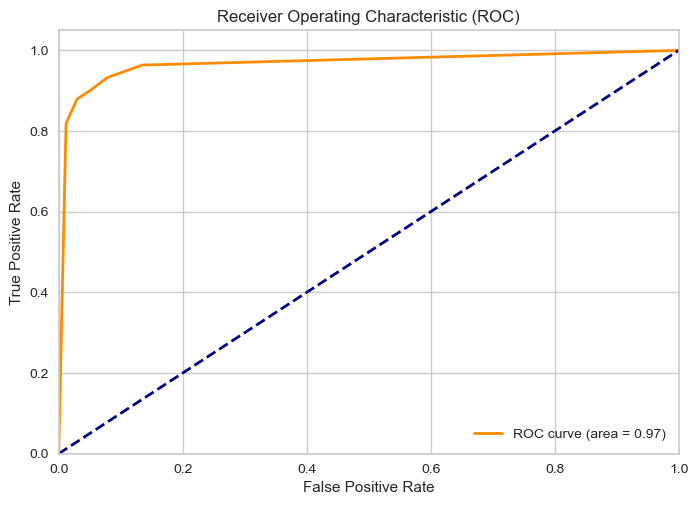

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Assuming KNN_model is your trained KNN classifier
y_score = KNN_model.predict_proba(X_test)[:,1]  # Probability estimates of the positive class

fpr, tpr, _ = roc_curve(y_test, y_score)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()


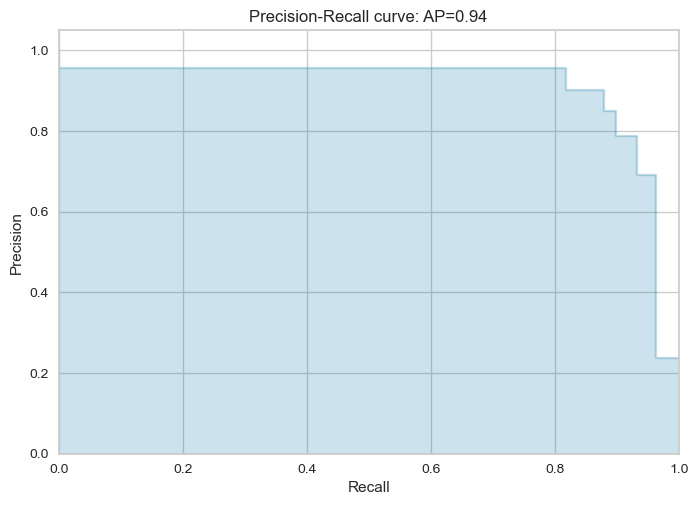

In [ ]:
from sklearn.metrics import precision_recall_curve, auc
import matplotlib.pyplot as plt

# Assuming KNN_model is your trained KNN classifier
y_score = KNN_model.predict_proba(X_test)[:, 1]  # Probability estimates of the positive class
precision, recall, _ = precision_recall_curve(y_test, y_score)
average_precision = auc(recall, precision)

plt.figure()
plt.step(recall, precision, color='b', alpha=0.2, where='post')
plt.fill_between(recall, precision, step='post', alpha=0.2, color='b')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title('Precision-Recall curve: AP={0:0.2f}'.format(average_precision))
plt.show()


#### Prediction

In [ ]:
KNN_Pred = {"Actual": y_test, "KNN_Pred":y_pred}
KNN_Pred = pd.DataFrame.from_dict(KNN_Pred)
KNN_Pred.head()

,Actual,KNN_Pred
5154,0,0
14201,0,0
12040,1,1
10175,0,0
3274,0,0
